In [5]:
#from google.colab import drive
#drive.mount('/content/drive')

In [6]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
data = pd.read_csv("drive/MyDrive/Data/ECommerce_consumer behaviour.csv")
data.head()

,order_id,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered,department_id,department,product_name
0,2425083,49125,1,2,18,NaN,17,1,0,13,pantry,baking ingredients
1,2425083,49125,1,2,18,NaN,91,2,0,16,dairy eggs,soy lactosefree
2,2425083,49125,1,2,18,NaN,36,3,0,16,dairy eggs,butter
3,2425083,49125,1,2,18,NaN,83,4,0,4,produce,fresh vegetables
4,2425083,49125,1,2,18,NaN,83,5,0,4,produce,fresh vegetables


In [8]:
data.shape

(2019501, 12)

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2019501 entries, 0 to 2019500
Data columns (total 12 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   order_id                int64  
 1   user_id                 int64  
 2   order_number            int64  
 3   order_dow               int64  
 4   order_hour_of_day       int64  
 5   days_since_prior_order  float64
 6   product_id              int64  
 7   add_to_cart_order       int64  
 8   reordered               int64  
 9   department_id           int64  
 10  department              object 
 11  product_name            object 
dtypes: float64(1), int64(9), object(2)
memory usage: 184.9+ MB


In [10]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
order_id,2019501.0,1.707013e+06,985983.196234,10.0,852649.0,1705004.0,2559031.0,3421080.0
user_id,2019501.0,1.030673e+05,59491.165074,2.0,51584.0,102690.0,154600.0,206209.0
order_number,2019501.0,1.715138e+01,17.525765,1.0,5.0,11.0,24.0,100.0
order_dow,2019501.0,2.735367e+00,2.093882,0.0,1.0,3.0,5.0,6.0
order_hour_of_day,2019501.0,1.343948e+01,4.241008,0.0,10.0,13.0,16.0,23.0
days_since_prior_order,1895159.0,1.138603e+01,8.970980,0.0,5.0,8.0,15.0,30.0
product_id,2019501.0,7.120590e+01,38.207275,1.0,31.0,83.0,107.0,134.0
add_to_cart_order,2019501.0,8.363173e+00,7.150059,1.0,3.0,6.0,11.0,137.0
reordered,2019501.0,5.897427e-01,0.491880,0.0,0.0,1.0,1.0,1.0
department_id,2019501.0,9.928349e+00,6.282933,1.0,4.0,9.0,16.0,21.0


## Checking missing value

In [11]:
data.isnull().sum()

order_id                       0
user_id                        0
order_number                   0
order_dow                      0
order_hour_of_day              0
days_since_prior_order    124342
product_id                     0
add_to_cart_order              0
reordered                      0
department_id                  0
department                     0
product_name                   0
dtype: int64

## Checking histograms of numerical features so far according to the data

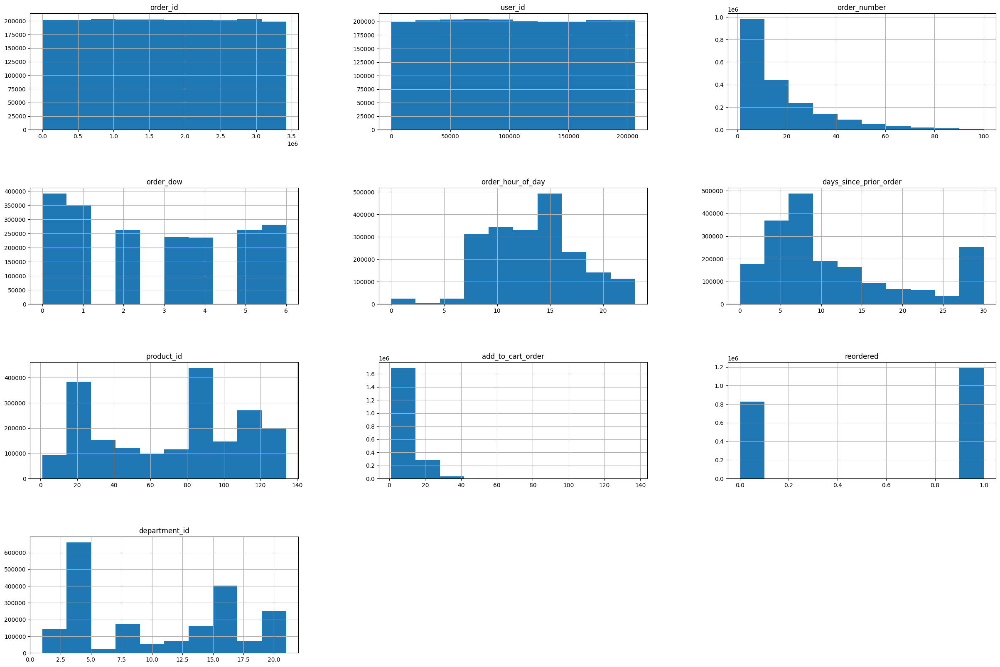

In [12]:
data.hist(figsize=(30,20))
plt.subplots_adjust(hspace=0.5);

<ipython-input-13-cd5d4ef26ebe>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.corr(), ax=ax, annot=True)


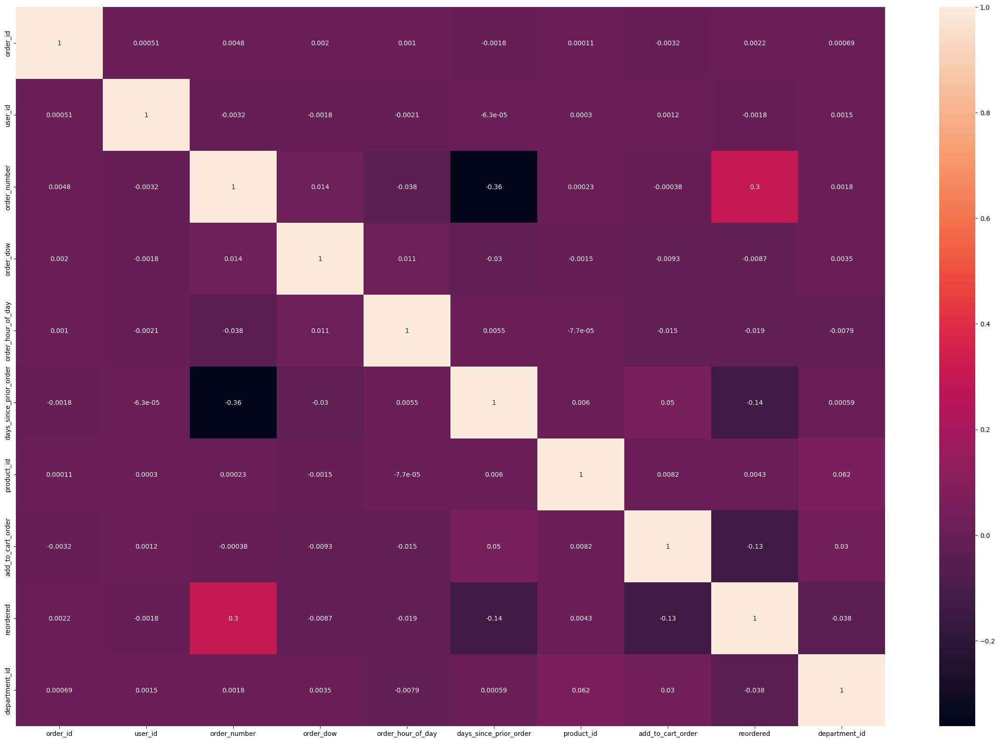

In [13]:
fig, ax = plt.subplots(figsize=(30, 20))
sns.heatmap(data.corr(), ax=ax, annot=True)
plt.show()

## Checking for categorical and numerical columns based on unique values.

In [14]:
data.nunique()

order_id                  200000
user_id                   105273
order_number                 100
order_dow                      7
order_hour_of_day             24
days_since_prior_order        31
product_id                   134
add_to_cart_order            137
reordered                      2
department_id                 21
department                    21
product_name                 134
dtype: int64

## Checking coulmns
### checking foe categorical values in each column

In [15]:
for column in data:
    if column == 'order_id' or column == "user_id":
        pass
    else:
        print(column)
        print(sorted(data[column].unique()),"\n")

order_number
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100] 

order_dow
[0, 1, 2, 3, 4, 5, 6] 

order_hour_of_day
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23] 

days_since_prior_order
[nan, 0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0] 

product_id
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 6

## Reordered

In [16]:
grouped = data.groupby("reordered")["product_id"].aggregate('count').reset_index()
grouped['Ratio'] = grouped["product_id"].apply(lambda x: x /grouped['product_id'].sum())
grouped

,reordered,product_id,Ratio
0,0,828515,0.410257
1,1,1190986,0.589743


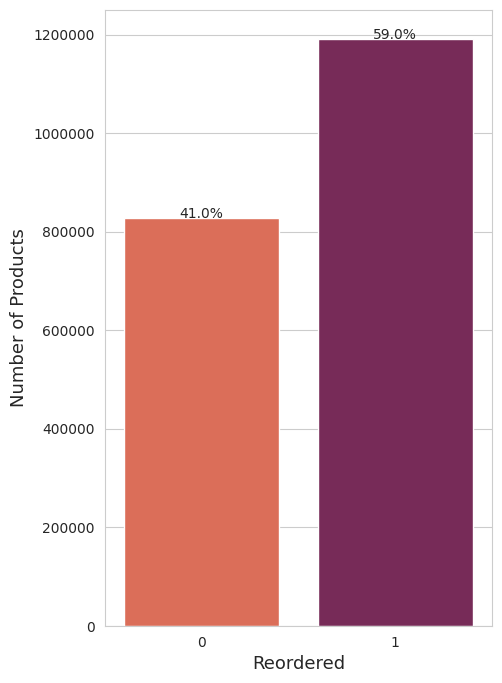

In [17]:
grouped = grouped.groupby(['reordered']).sum()['product_id'].sort_values(ascending=True)

sns.set_style('whitegrid')
f, ax = plt.subplots(figsize=(5, 8))
sns.barplot(x=grouped.index, y=grouped.values, palette='rocket_r')

grouped_pct = grouped/grouped.sum() * 100
for i, v in enumerate(grouped.values):
    ax.text(i, v+3, f'{grouped_pct.values[i]:.1f}%', ha='center', fontsize=10)

plt.ylabel('Number of Products', fontsize=13)
plt.xlabel('Reordered', fontsize=13)
plt.ticklabel_format(style='plain', axis='y')
plt.show()

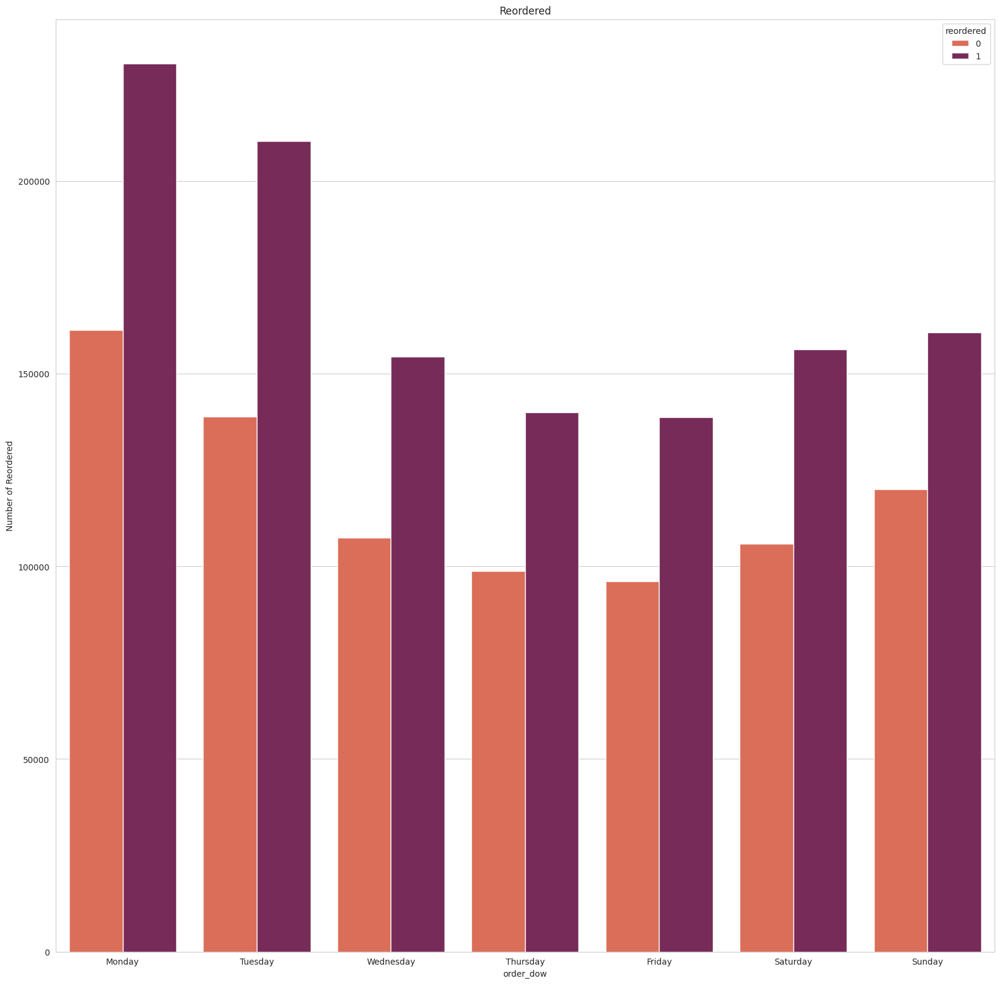

In [18]:
plt.figure(figsize=(20,20))
order = sorted(data["order_dow"].unique())
ax = sns.countplot(data=data, x="order_dow", hue=data["reordered"], order=order ,palette='rocket_r')
ax.set_xticklabels(["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]) # fixed the x-axis labels
ax.set_ylabel('Number of Reordered')
plt.title("Reordered")
plt.show()

In [19]:
seris = data.groupby('product_name')['user_id'].count().sort_values(ascending=False).head(10)
df = pd.DataFrame()
for index in seris.index:
  df[index] = data[data['product_name'] == index]['reordered'].value_counts()
df


,fresh fruits,fresh vegetables,packaged vegetables fruits,yogurt,packaged cheese,milk,water seltzer sparkling water,chips pretzels,soy lactosefree,bread
1,162355,126171,69872,62464,35864,43162,38467,26615,27251,24540
0,63684,86440,39724,28287,25638,11988,14097,18691,12138,11841


Text(158.22222222222223, 0.5, 'reordered')

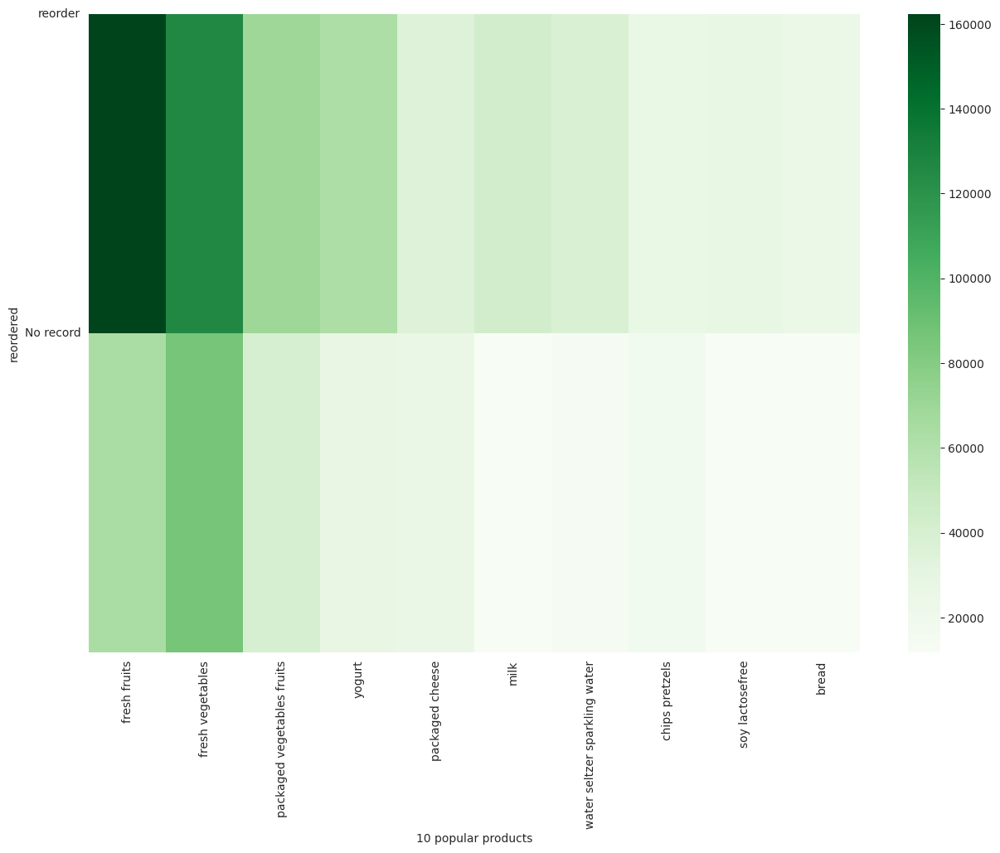

In [20]:
plt.figure(figsize=(15,10))
sns.heatmap(df, cmap='Greens')
plt.yticks([0,1],["reorder" , "No record"])
plt.xlabel("10 popular products")
plt.yticks(rotation=0)
plt.ylabel("reordered")

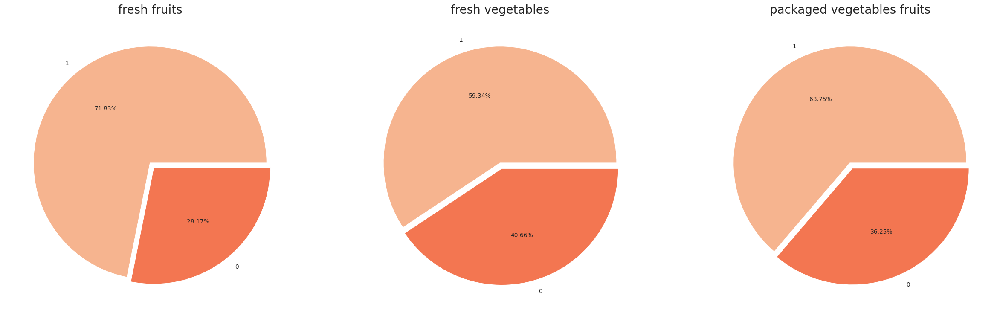

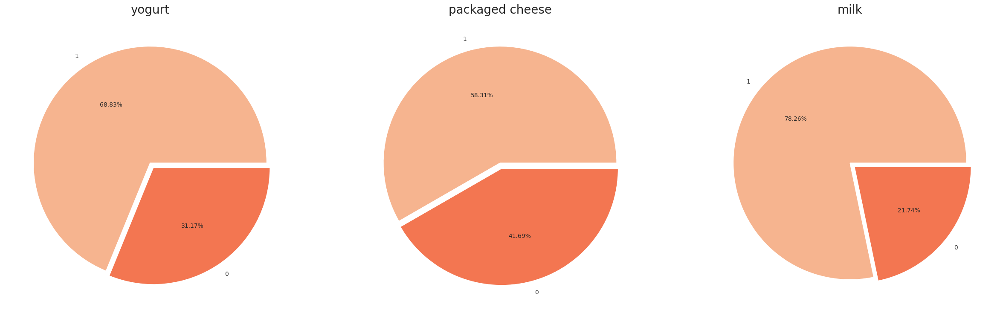

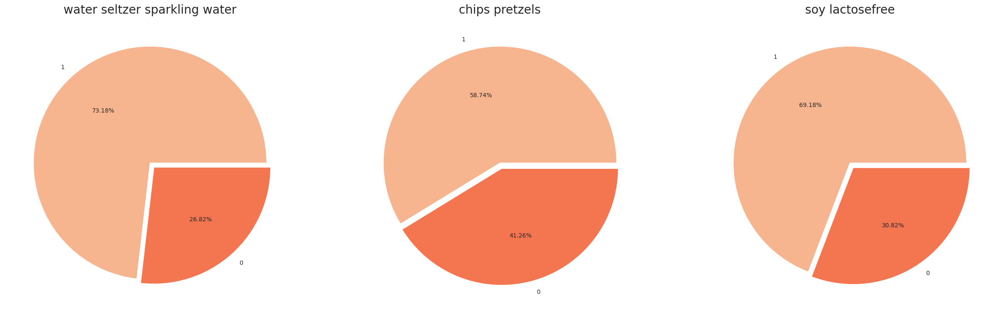

In [21]:
c = df.columns
for i in range (0 ,len(df.columns) - 3 ,3):
  plt.figure(figsize=(30,15))

  palette_color = sns.color_palette('rocket_r')
  explode = [0, 0.05]

  plt.subplot(131)
  plt.title(c[i],fontsize=20)
  plt.pie(df[c[i]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(132)
  plt.title(c[i + 1],fontsize=20)
  plt.pie(df[c[i + 1]] ,labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(133)
  plt.title(c[i + 2],fontsize=20)
  plt.pie(df[c[i+2]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')


In [22]:
seris = data.groupby('product_name')['user_id'].count().sort_values(ascending=False).tail(10)
df = pd.DataFrame()
for index in seris.index:
  df[index] = data[data['product_name'] == index]['reordered'].value_counts()
df

,first aid,skin care,shave needs,specialty wines champagnes,eye ear care,kitchen supplies,baby bath body care,baby accessories,beauty,frozen juice
0,548,475,482,321,473,441,372,244,306,158
1,145,179,164,293,125,120,143,260,81,121


Text(158.22222222222223, 0.5, 'reordered')

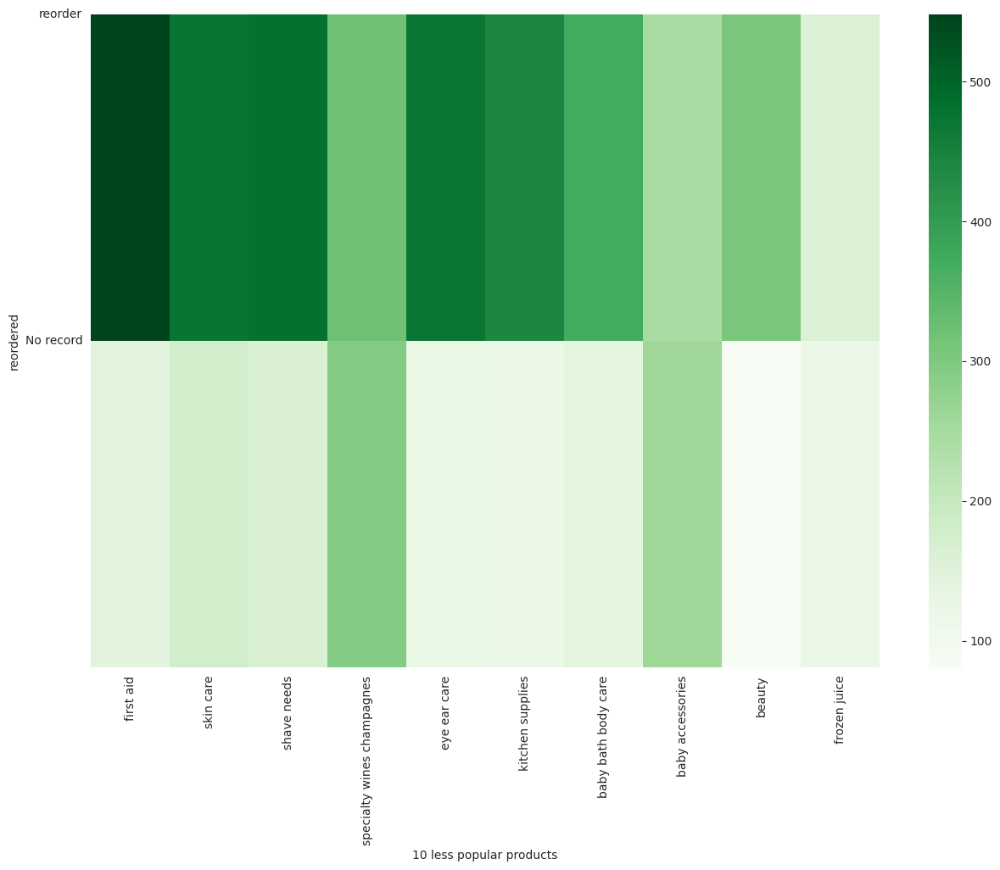

In [23]:
plt.figure(figsize=(15,10))
sns.heatmap(df, cmap='Greens')
plt.yticks([0,1],["reorder" , "No record"])
plt.xlabel("10 less popular products")
plt.yticks(rotation=0)
plt.ylabel("reordered")

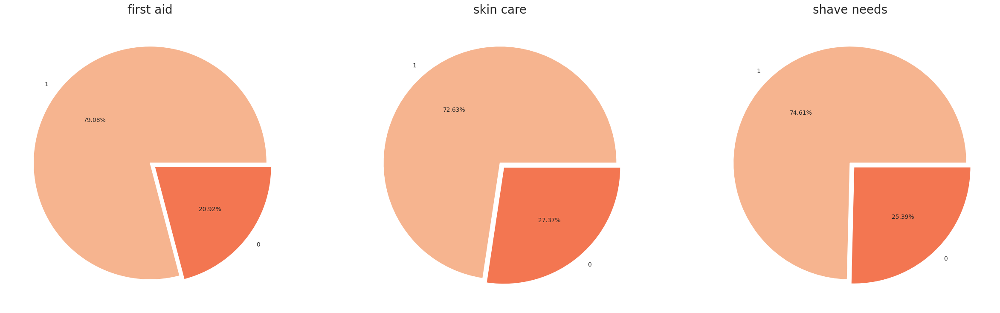

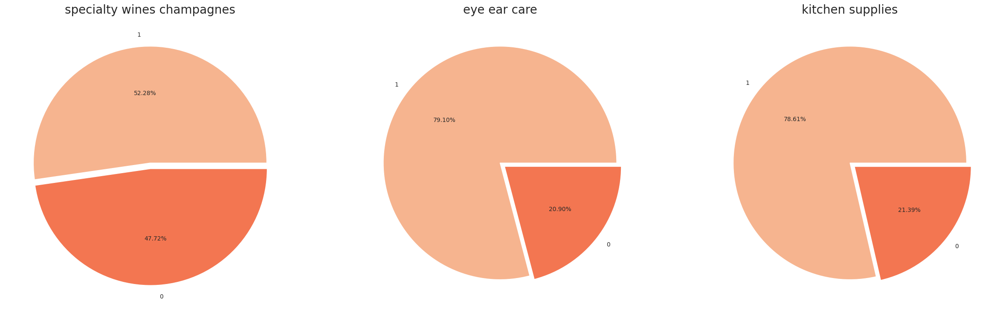

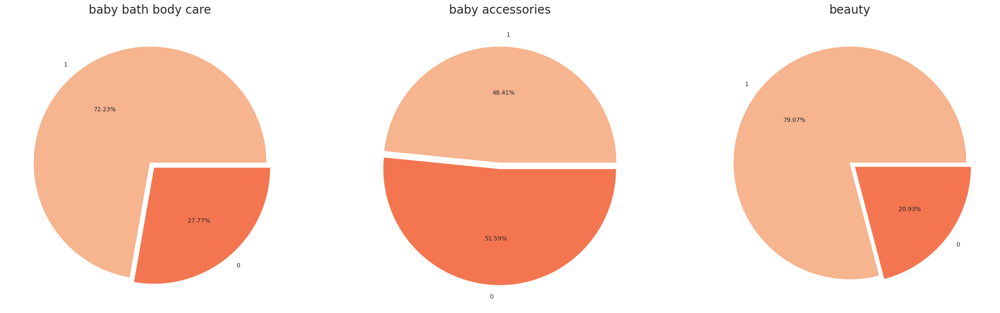

In [24]:
c = df.columns
for i in range (0 ,len(df.columns) - 3 ,3):
  plt.figure(figsize=(30,15))

  palette_color = sns.color_palette('rocket_r')
  explode = [0, 0.05]

  plt.subplot(131)
  plt.title(c[i],fontsize=20)
  plt.pie(df[c[i]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(132)
  plt.title(c[i + 1],fontsize=20)
  plt.pie(df[c[i + 1]] ,labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(133)
  plt.title(c[i + 2],fontsize=20)
  plt.pie(df[c[i+2]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

## 9 popular Department

In [25]:
seris = data.groupby('department')['user_id'].count().sort_values(ascending=False).head(10)
df = pd.DataFrame()
for index in seris.index:
  df[index] = data[data['department'] == index]['reordered'].value_counts()
df

,produce,dairy eggs,snacks,beverages,frozen,pantry,bakery,canned goods,deli,dry goods pasta
1,382425,225798,103784,110117,75135,40453,45969,30264,39917,24882
0,206571,111117,76908,58009,64401,75809,27014,35789,25259,29172


Text(158.22222222222223, 0.5, 'reordered')

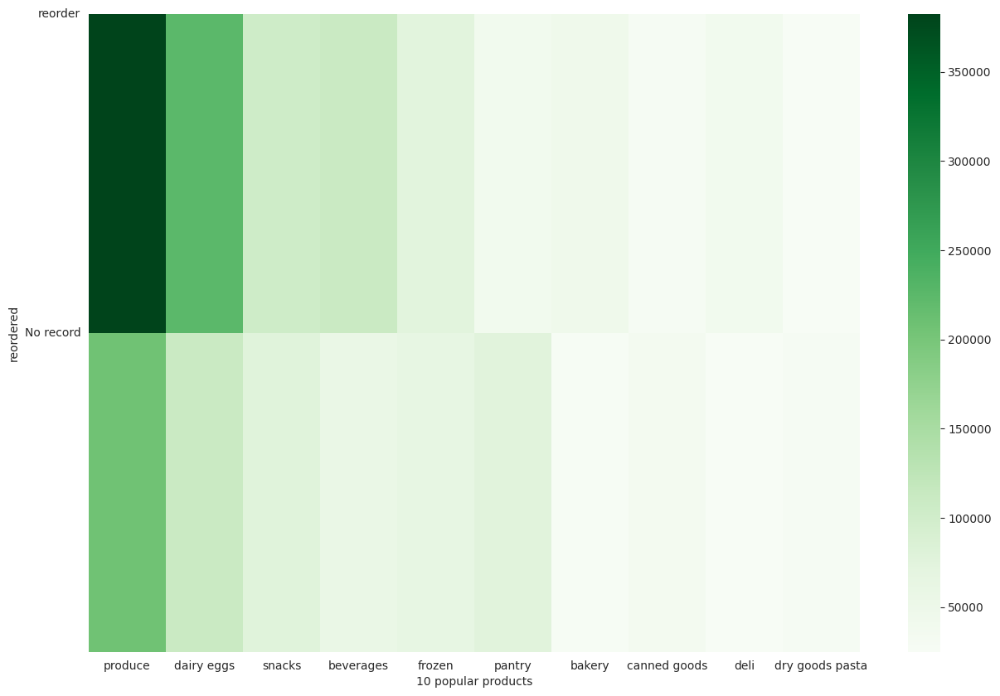

In [26]:
plt.figure(figsize=(15,10))
sns.heatmap(df, cmap='Greens')
plt.yticks([0,1],["reorder" , "No record"])
plt.xlabel("10 popular products")
plt.yticks(rotation=0)
plt.ylabel("reordered")

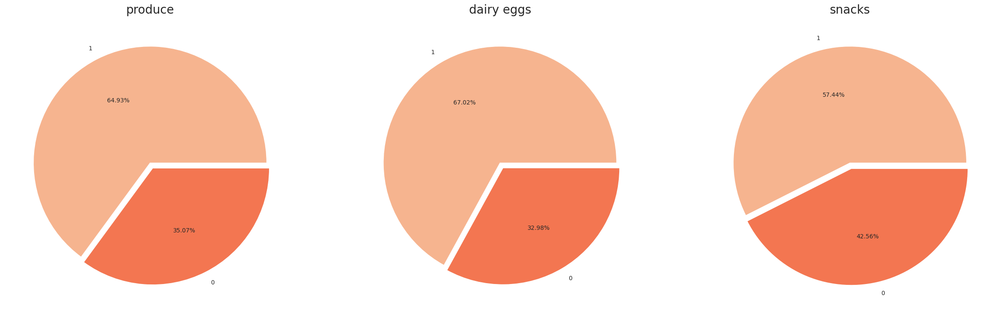

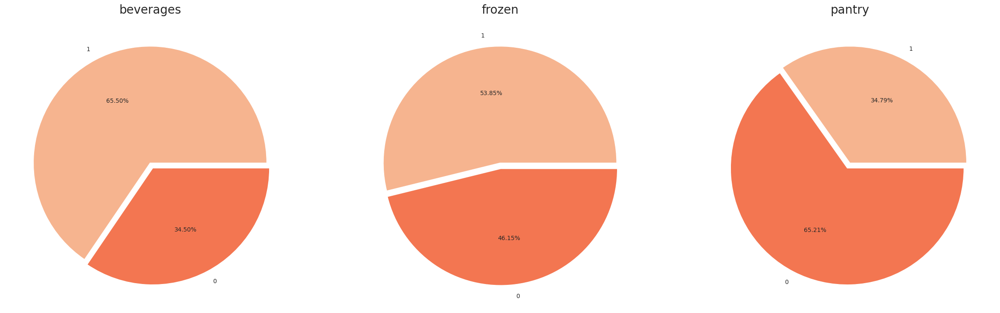

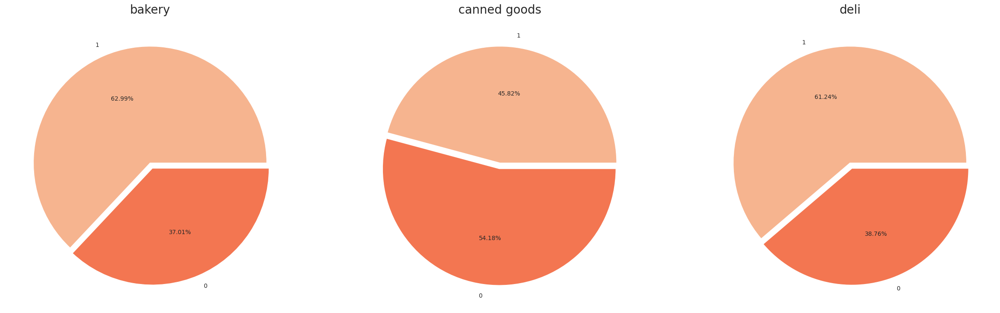

In [27]:
c = df.columns
for i in range (0 ,len(df.columns) - 3 ,3):
  plt.figure(figsize=(30,15))

  palette_color = sns.color_palette('rocket_r')
  explode = [0, 0.05]

  plt.subplot(131)
  plt.title(c[i],fontsize=20)
  plt.pie(df[c[i]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(132)
  plt.title(c[i + 1],fontsize=20)
  plt.pie(df[c[i + 1]] ,labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(133)
  plt.title(c[i + 2],fontsize=20)
  plt.pie(df[c[i+2]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

In [28]:
seris = data.groupby('department')['user_id'].count().sort_values(ascending=False).tail(10)
df = pd.DataFrame()
for index in seris.index:
  df[index] = data[data['department'] == index]['reordered'].value_counts()
df

,breakfast,meat seafood,personal care,babies,international,alcohol,pets,missing,other,bulk
1,25046,25326,9191,15069,6039,5264,3634,1860,905,1230
0,19559,18945,18943,10871,10699,4175,2379,2889,1335,903


Text(158.22222222222223, 0.5, 'reordered')

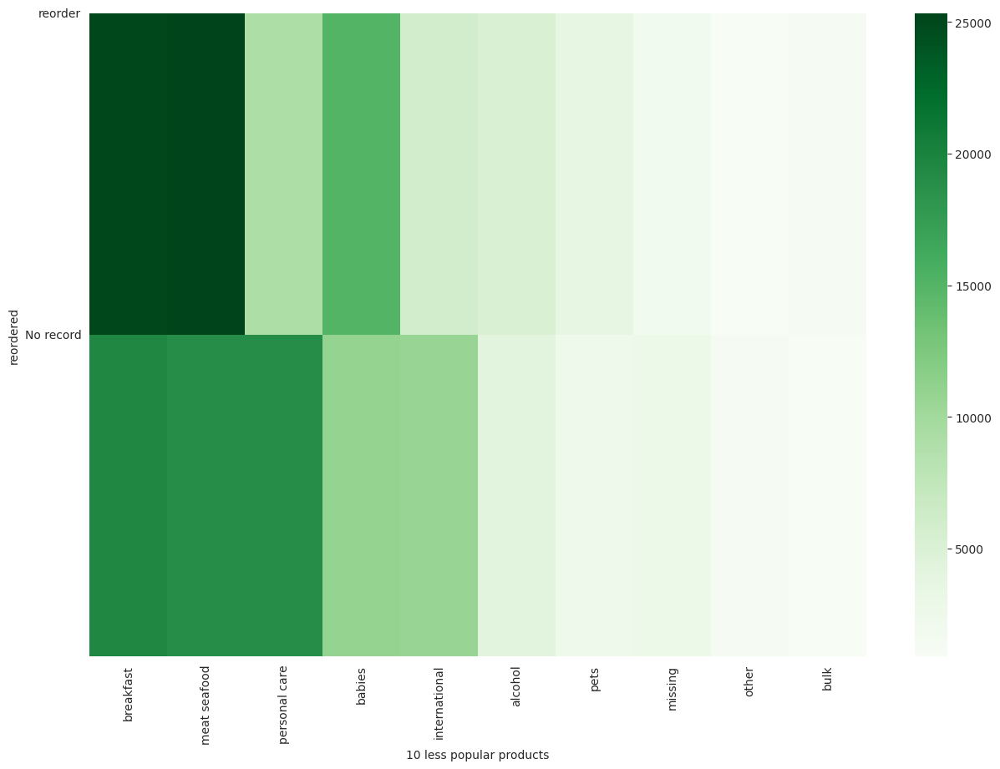

In [29]:
plt.figure(figsize=(15,10))
sns.heatmap(df, cmap='Greens')
plt.yticks([0,1],["reorder" , "No record"])
plt.xlabel("10 less popular products")
plt.yticks(rotation=0)
plt.ylabel("reordered")

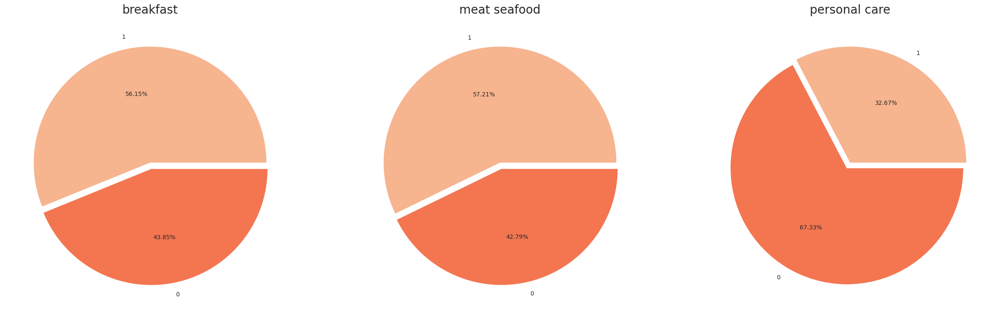

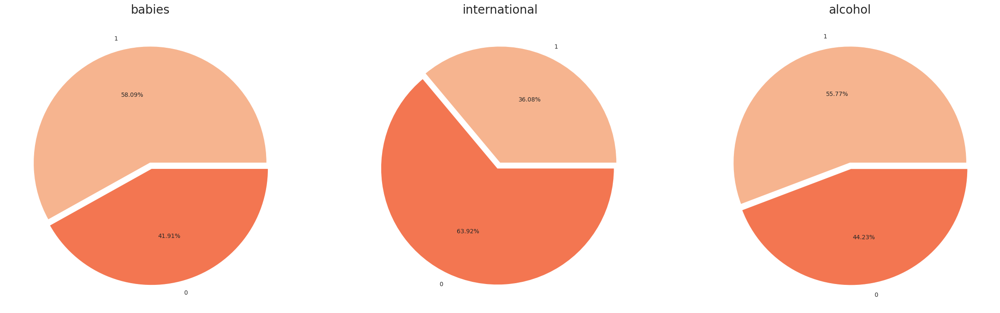

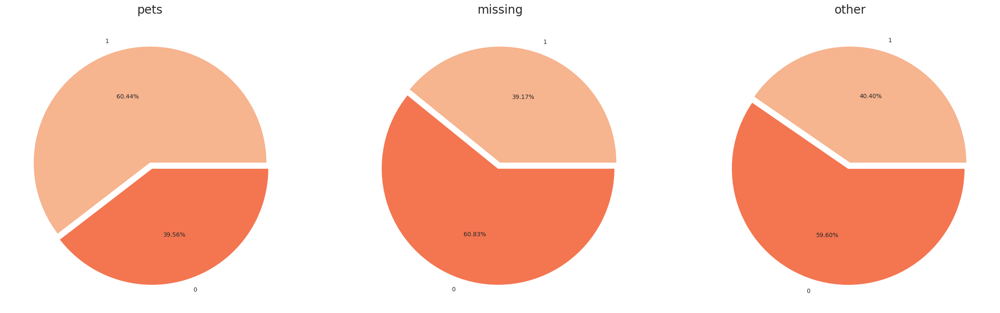

In [30]:
c = df.columns
for i in range (0 ,len(df.columns) - 3 ,3):
  plt.figure(figsize=(30,15))

  palette_color = sns.color_palette('rocket_r')
  explode = [0, 0.05]

  plt.subplot(131)
  plt.title(c[i] ,fontsize=20)
  plt.pie(df[c[i]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(132)
  plt.title(c[i + 1] ,fontsize=20)
  plt.pie(df[c[i + 1]] ,labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

  plt.subplot(133)
  plt.title(c[i + 2] ,fontsize=20)
  plt.pie(df[c[i+2]] , labels=[1,0], colors=palette_color,
        explode=explode, autopct='%1.2f%%')

Text(0.5, 0, 'add_to_cart_order')

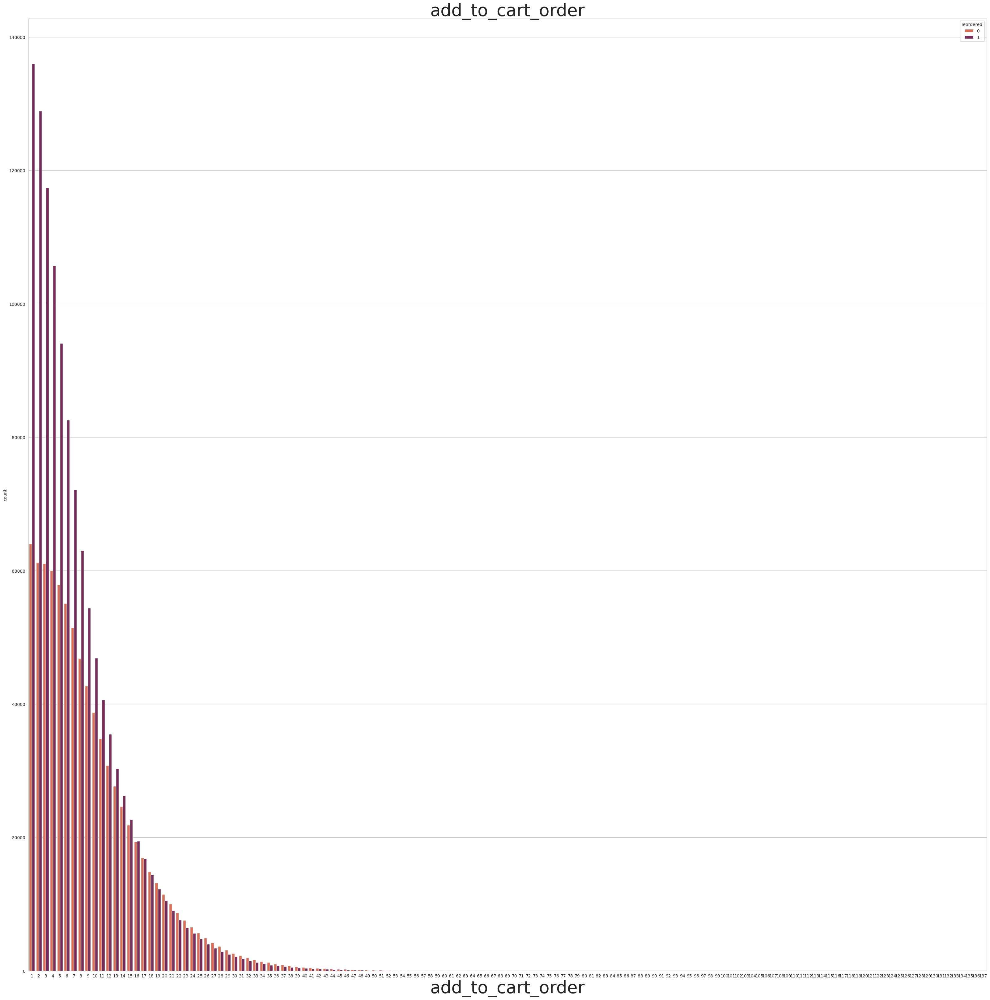

In [31]:
plt.figure(figsize=(40,40))
order = sorted(data["add_to_cart_order"].unique())
sns.countplot(data=data, x="add_to_cart_order", hue=data["reordered"], order=order ,palette='rocket_r')
plt.title("add_to_cart_order" ,fontsize=40)
plt.xlabel("add_to_cart_order" ,fontsize=40)

Text(0.5, 0, 'order_hour_of_day')

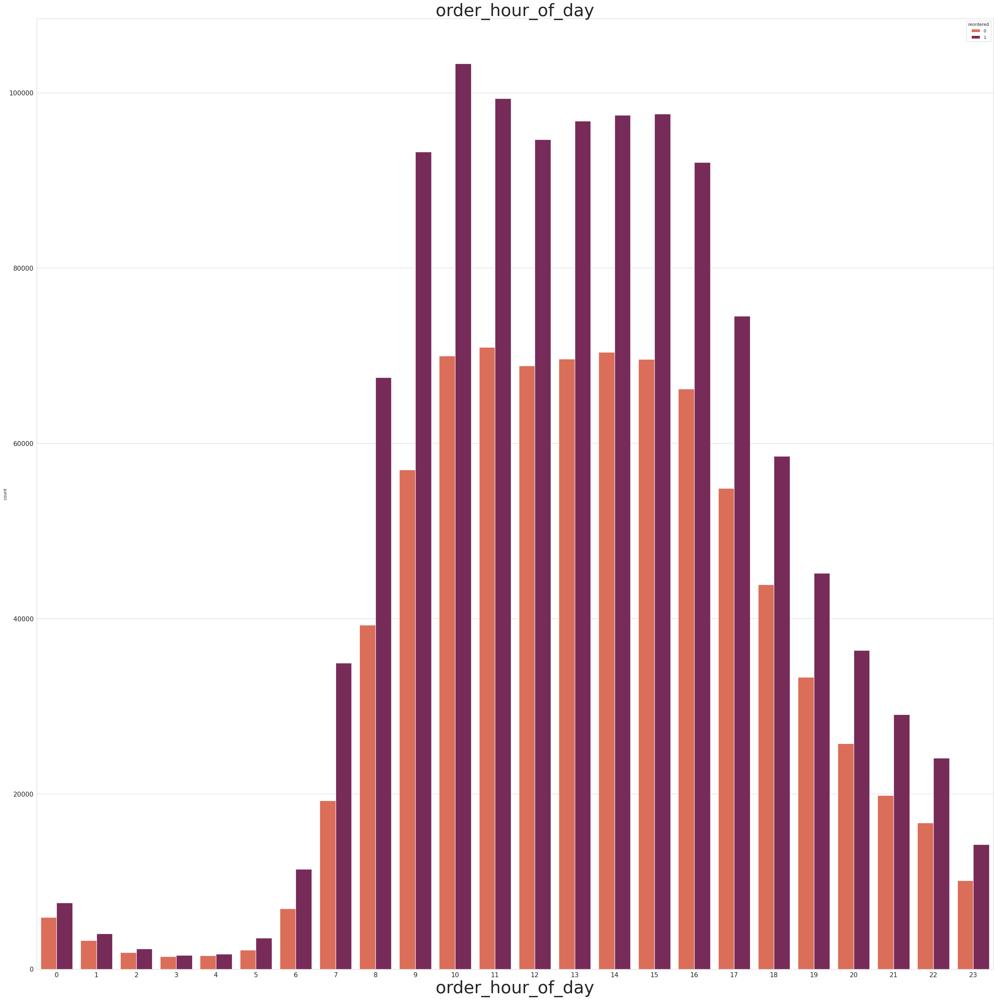

In [32]:
plt.rc('xtick', labelsize=15) 
plt.rc('ytick', labelsize=15) 

plt.figure(figsize=(40,40))
order = sorted(data["order_hour_of_day"].unique())
sns.countplot(data=data, x="order_hour_of_day", hue=data["reordered"], order=order ,palette='rocket_r')
plt.title("order_hour_of_day" ,fontsize=40)
plt.xlabel("order_hour_of_day" ,fontsize=40)

## order_dow

In [33]:
def order_time(x):
    return f'{"morning" if x in range(6, 12) else "afternoon" if x in range(12, 18) else "evening" if x in range(18, 23) else "night"}'

In [34]:
data['order_time_period'] = data['order_hour_of_day'].apply(order_time)
data

,order_id,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered,department_id,department,product_name,order_time_period
0,2425083,49125,1,2,18,NaN,17,1,0,13,pantry,baking ingredients,evening
1,2425083,49125,1,2,18,NaN,91,2,0,16,dairy eggs,soy lactosefree,evening
2,2425083,49125,1,2,18,NaN,36,3,0,16,dairy eggs,butter,evening
3,2425083,49125,1,2,18,NaN,83,4,0,4,produce,fresh vegetables,evening
4,2425083,49125,1,2,18,NaN,83,5,0,4,produce,fresh vegetables,evening
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019496,3390742,199430,16,3,18,5.0,83,8,0,4,produce,fresh vegetables,evening
2019497,458285,128787,42,2,19,3.0,115,1,1,7,beverages,water seltzer sparkling water,evening
2019498,458285,128787,42,2,19,3.0,32,2,1,4,produce,packaged produce,evening
2019499,458285,128787,42,2,19,3.0,32,3,1,4,produce,packaged produce,evening


In [35]:
data.pivot_table(index='order_dow',columns='order_time_period',values='user_id',aggfunc=['count'])

count                       
order_time_period afternoon evening morning  night
order_dow                                         
0                    196603   60195  123876  11157
1                    158970   51825  129591   8850
2                    120927   45497   87562   7926
3                    112185   41737   77609   7199
4                    107170   45359   74338   8017
5                    121577   42311   89662   8607
6                    135073   45737   90397   9544

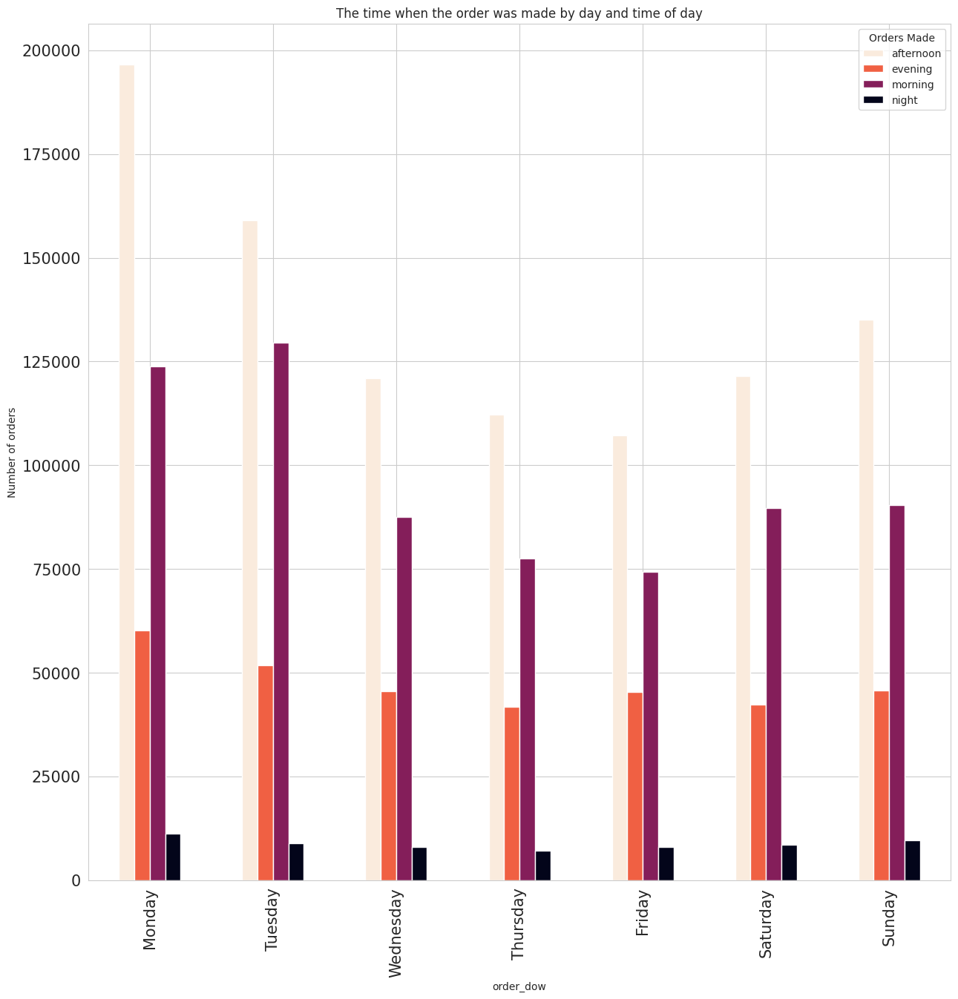

In [36]:
# Define the color palette
color_palette = plt.get_cmap('rocket_r')

# Generate the plot
orders_by_day_time = data.pivot_table(
    index='order_dow',
    columns='order_time_period',
    values='user_id',
    aggfunc='count'
)

ax = orders_by_day_time.plot(kind='bar', figsize=(15, 15), color=color_palette(np.linspace(0, 1, len(orders_by_day_time.columns))))
ax.set_title('The time when the order was made by day and time of day')
ax.set_xticklabels(["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]) # fixed the x-axis labels
ax.set_ylabel('Number of orders')
ax.legend(title='Orders Made', bbox_to_anchor=(1.0, 1.0))
plt.show()

<ipython-input-37-a90eaa70d0ab>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  day_hour_df_piv = day_hour_df.pivot('order_dow', 'order_hour_of_day', 'order_number')/df.shape[0]


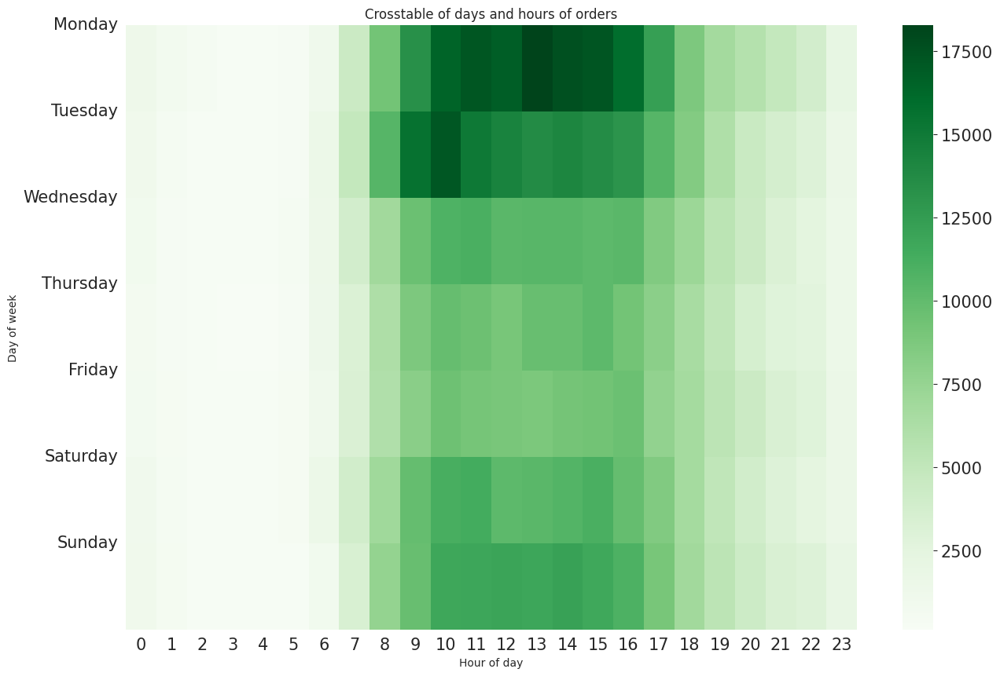

In [37]:
day_hour_df = data.groupby(["order_dow", "order_hour_of_day"])["order_number"].aggregate("count").reset_index()
day_hour_df_piv = day_hour_df.pivot('order_dow', 'order_hour_of_day', 'order_number')/df.shape[0]

plt.figure(figsize=(15,10))
sns.heatmap(day_hour_df_piv, cmap='Greens')
plt.yticks([0,1, 2, 3, 4, 5, 6],["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"])
plt.xlabel("Hour of day")
plt.yticks(rotation=0)
plt.ylabel("Day of week")


plt.title("Crosstable of days and hours of orders");

Text(0.5, 1.0, 'order_hour_of_day')

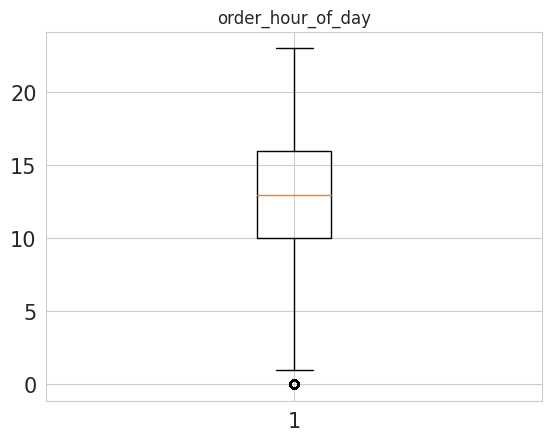

In [38]:
plt.boxplot(data["order_hour_of_day"]);
plt.title("order_hour_of_day")

In [39]:
seris = data.groupby('product_name')['user_id'].count().sort_values(ascending=False).head(10)
df = pd.DataFrame()
for index in seris.index:
  df[index] = data[data['product_name'] == index]['order_dow'].value_counts()
df

,fresh fruits,fresh vegetables,packaged vegetables fruits,yogurt,packaged cheese,milk,water seltzer sparkling water,chips pretzels,soy lactosefree,bread
0,44727,46643,23169,17192,12526,10113,8588,7944,7457,7193
1,41126,36440,19230,16725,10433,9779,9610,7909,7019,6266
6,30245,31831,15268,11956,8734,7182,6355,6057,5370,5103
5,29265,25059,13526,11862,7853,7450,7327,6185,5023,4826
2,28830,26481,13919,12144,7872,7337,7378,5979,5236,4602
3,26102,23243,12316,10712,7019,6562,6701,5588,4737,4247
4,25744,22914,12168,10160,7065,6727,6605,5644,4547,4144


Text(152.22222222222223, 0.5, 'Day of week')

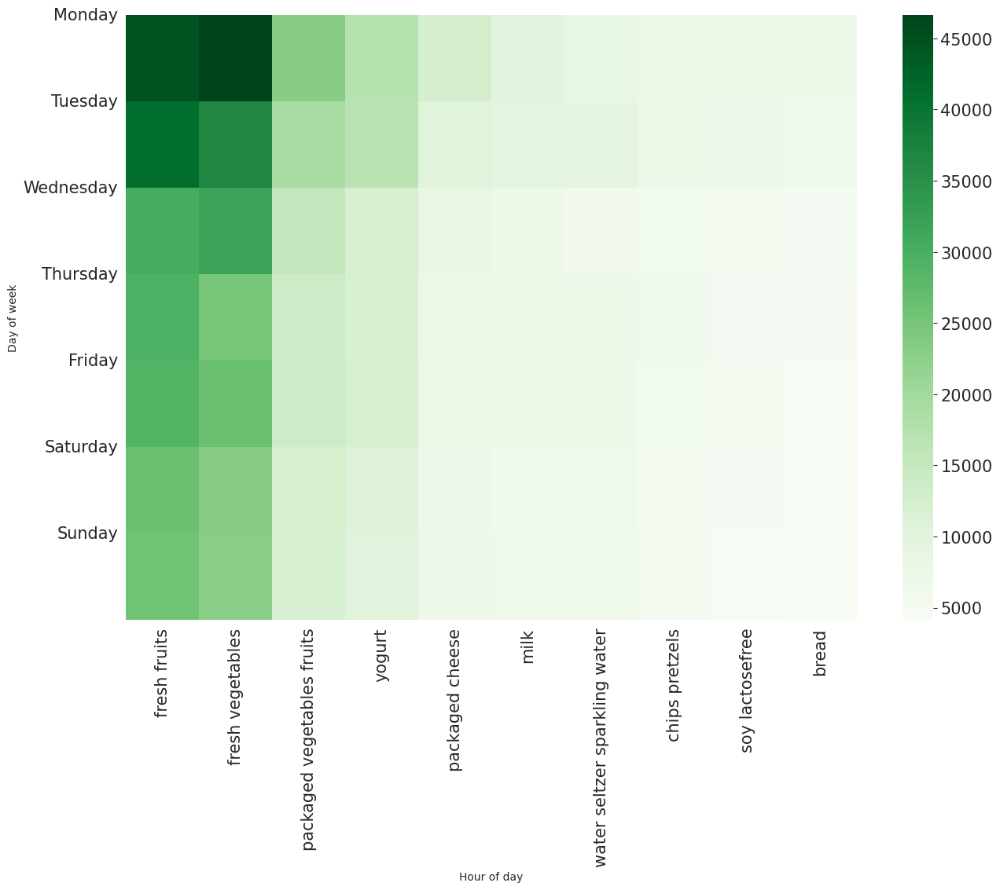

In [40]:
plt.figure(figsize=(15,10))
sns.heatmap(df, cmap='Greens')
plt.yticks([0,1, 6, 5, 2, 3, 4],["Monday", "Tuesday","Sunday","Saturday", "Wednesday", "Thursday", "Friday"])
plt.xlabel("Hour of day")
plt.yticks(rotation=0)
plt.ylabel("Day of week")

In [41]:
seris = data.groupby('department')['user_id'].count().sort_values(ascending=False).head(10)
df = pd.DataFrame()
for index in seris.index:
  df[index] = data[data['department'] == index]['order_dow'].value_counts()
df

,produce,dairy eggs,snacks,beverages,frozen,pantry,bakery,canned goods,deli,dry goods pasta
0,122185,64697,30662,27576,27922,22126,14299,14301,13106,11496
1,103835,58934,33573,29860,22226,18782,12483,10935,11247,9134
6,83083,46059,22251,21381,21389,17107,10118,10097,9050,7942
2,74381,44206,24900,23066,17362,15073,9449,8300,8364,6937
5,73188,44400,24219,23534,18148,15417,9703,8099,8394,6461
3,66510,39549,22824,21483,16601,13971,8558,7312,7551,6243
4,65814,39070,22263,21226,15888,13786,8373,7009,7464,5841


Text(152.22222222222223, 0.5, 'Day of week')

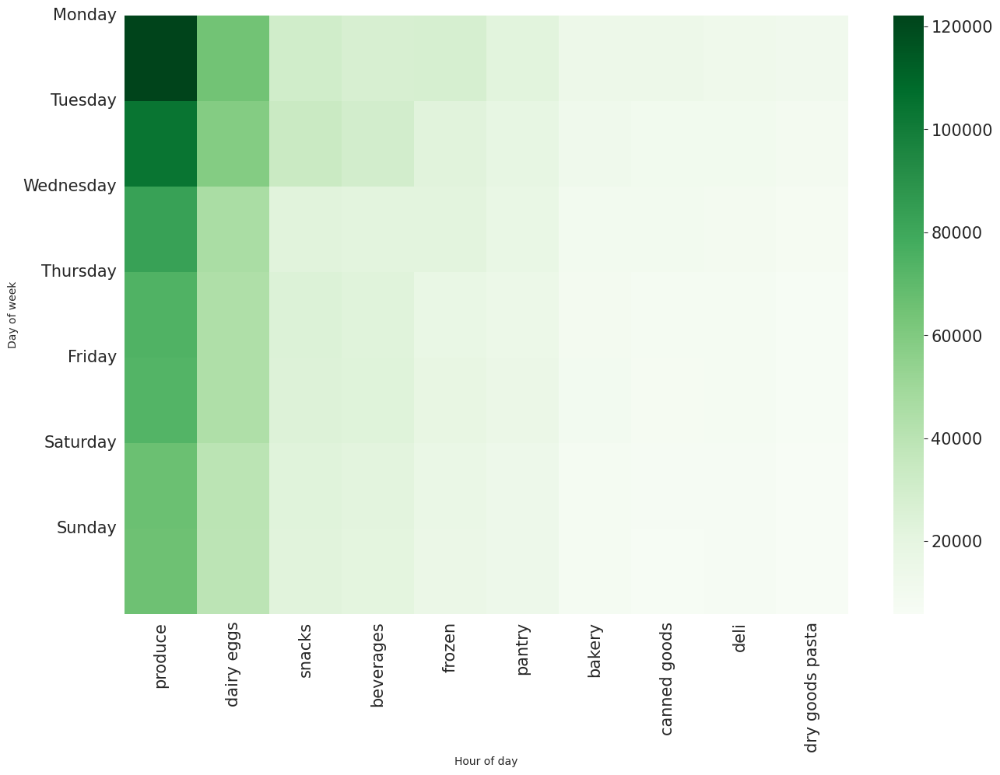

In [42]:
plt.figure(figsize=(15,10))
sns.heatmap(df, cmap='Greens')
plt.yticks([0,1, 6, 5, 2, 3, 4],["Monday", "Tuesday","Sunday","Saturday", "Wednesday", "Thursday", "Friday"])
plt.xlabel("Hour of day")
plt.yticks(rotation=0)
plt.ylabel("Day of week")

## days_since_prior_order

### fill missing value 

In [43]:
data["days_since_prior_order"].fillna(0,inplace=True) 

In [44]:
data["days_since_prior_order"].mean()

10.684989014613016

In [45]:
data['days_since_prior_order']= data['days_since_prior_order'].astype(np.int64)

In [46]:
data.isnull().sum()

order_id                  0
user_id                   0
order_number              0
order_dow                 0
order_hour_of_day         0
days_since_prior_order    0
product_id                0
add_to_cart_order         0
reordered                 0
department_id             0
department                0
product_name              0
order_time_period         0
dtype: int64

Text(0.5, 0, 'days_since_prior_order')

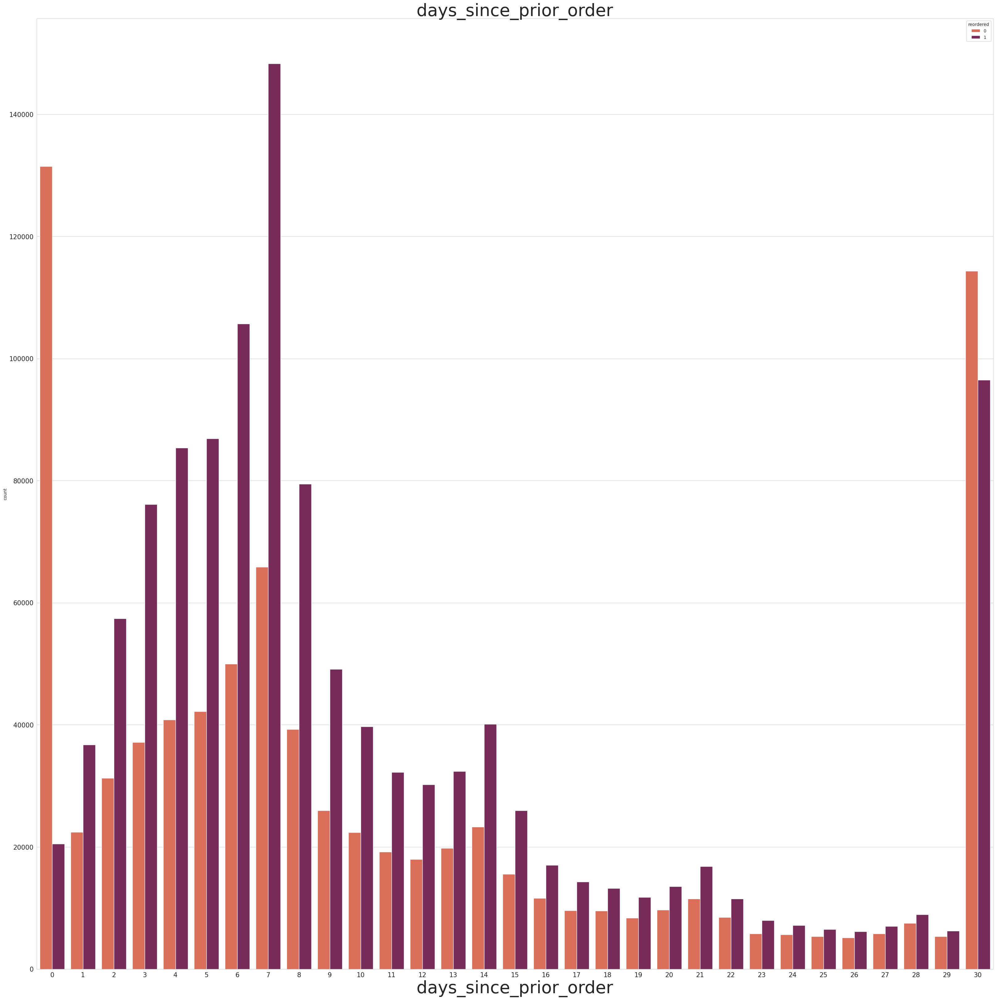

In [47]:
plt.rc('xtick', labelsize=15) 
plt.rc('ytick', labelsize=15) 

plt.figure(figsize=(40,40))
order = sorted(data["days_since_prior_order"].unique())
sns.countplot(data=data, x="days_since_prior_order", hue=data["reordered"], order=order ,palette='rocket_r')
plt.title("days_since_prior_order" ,fontsize=40)
plt.xlabel("days_since_prior_order" ,fontsize=40)

# preprocessing

In [48]:
newData = data.drop(["product_name",'department' ,'order_time_period'] ,axis = 1)
newData

,order_id,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered,department_id
0,2425083,49125,1,2,18,0,17,1,0,13
1,2425083,49125,1,2,18,0,91,2,0,16
2,2425083,49125,1,2,18,0,36,3,0,16
3,2425083,49125,1,2,18,0,83,4,0,4
4,2425083,49125,1,2,18,0,83,5,0,4
...,...,...,...,...,...,...,...,...,...,...
2019496,3390742,199430,16,3,18,5,83,8,0,4
2019497,458285,128787,42,2,19,3,115,1,1,7
2019498,458285,128787,42,2,19,3,32,2,1,4
2019499,458285,128787,42,2,19,3,32,3,1,4


### percentile

In [49]:
for column in newData.columns:   
    if(column != "order_id" or column != "user_id"):  
    
      lower_limit, upper_limit = np.percentile(a=data[column],q=[1,99])

      percentileData = data[(data[column] > lower_limit) & (data[column] < upper_limit)]
    
percentileData = percentileData.drop(['department',	'product_name',	'order_time_period'] ,axis = 1)
percentileData

,order_id,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered,department_id
0,2425083,49125,1,2,18,0,17,1,0,13
1,2425083,49125,1,2,18,0,91,2,0,16
2,2425083,49125,1,2,18,0,36,3,0,16
3,2425083,49125,1,2,18,0,83,4,0,4
4,2425083,49125,1,2,18,0,83,5,0,4
...,...,...,...,...,...,...,...,...,...,...
2019496,3390742,199430,16,3,18,5,83,8,0,4
2019497,458285,128787,42,2,19,3,115,1,1,7
2019498,458285,128787,42,2,19,3,32,2,1,4
2019499,458285,128787,42,2,19,3,32,3,1,4


### IQR

In [50]:
for column in newData.columns:  
    if(column != "order_id" or column != "user_id"): 
      q1 = data[column].quantile(0.25)    # First Quartile
      q3 = data[column].quantile(0.75)    # Third Quartile
      IQR = q3 - q1                            # Inter Quartile Range

      llimit = q1 - 1.5*IQR                       # Lower Limit
      ulimit = q3 + 1.5*IQR                        # Upper Limit

      IQRData = data[(data[column] > llimit) & (data[column] < ulimit)]
      
IQRData
IQRData = IQRData.drop(['department',	'product_name',	'order_time_period'],axis = 1)
IQRData

,order_id,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered,department_id
0,2425083,49125,1,2,18,0,17,1,0,13
1,2425083,49125,1,2,18,0,91,2,0,16
2,2425083,49125,1,2,18,0,36,3,0,16
3,2425083,49125,1,2,18,0,83,4,0,4
4,2425083,49125,1,2,18,0,83,5,0,4
...,...,...,...,...,...,...,...,...,...,...
2019496,3390742,199430,16,3,18,5,83,8,0,4
2019497,458285,128787,42,2,19,3,115,1,1,7
2019498,458285,128787,42,2,19,3,32,2,1,4
2019499,458285,128787,42,2,19,3,32,3,1,4


In [103]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import DBSCAN

# Train Models

## K-means


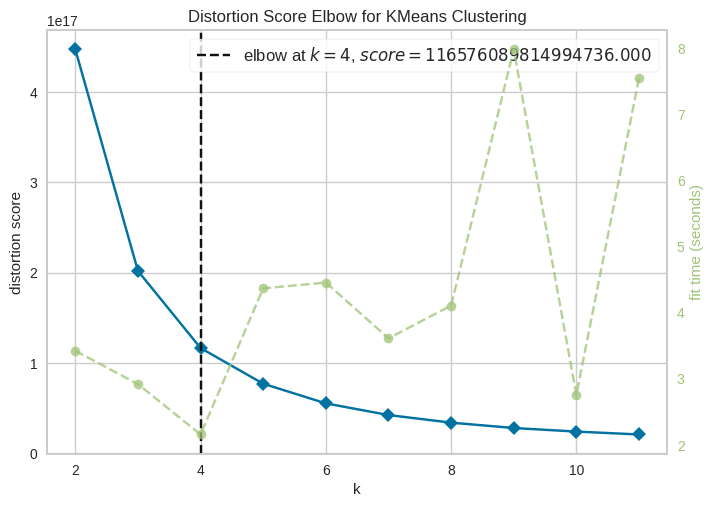

In [64]:
model = KMeans(n_init='auto')
visualiser = KElbowVisualizer(model, k=(2,12))
visualiser.fit(percentileData)        
visualiser.show();

In [65]:
kmeans = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(percentileData)
y_kmeans = kmeans.predict(percentileData)
l = kmeans.labels_
l

array([2, 2, 2, ..., 3, 3, 3], dtype=int32)

In [66]:
kmeans.inertia_

1.1657471394857322e+17

In [67]:
pca = PCA(n_components=2)
temp = pca.fit_transform(percentileData)

In [68]:
temp

array([[  717738.62716703,   -53963.98159168],
       [  717738.62716758,   -53963.98157589],
       [  717738.62716707,   -53963.98158679],
       ...,
       [-1249054.02768163,    25829.87696105],
       [-1249054.02768166,    25829.8769612 ],
       [-1249054.02768089,    25829.87697965]])

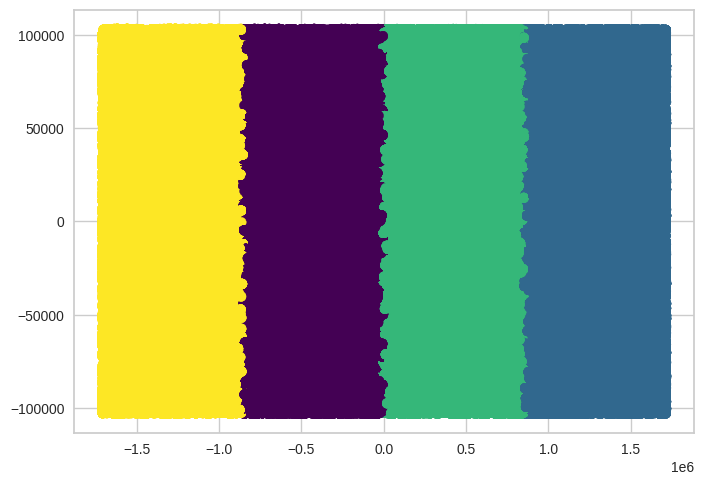

In [69]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')


In [70]:
pca = PCA(n_components=3)
temp = pca.fit_transform(percentileData)

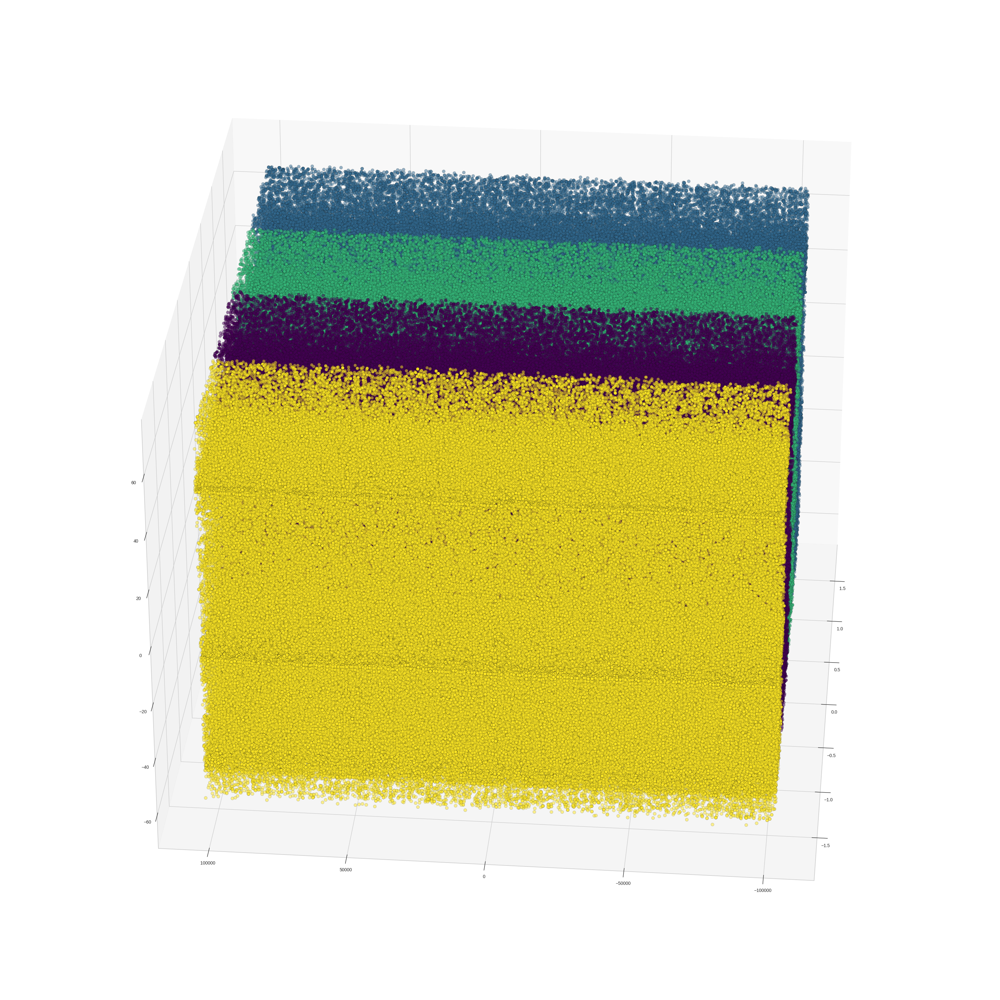

In [71]:
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2],c = y_kmeans, s=50, cmap='viridis', edgecolor='k', alpha=0.5)
ax.view_init(30, 185)
plt.show()

## MinMaxScaler

In [ ]:
min_max = MinMaxScaler()
min_max_data = min_max.fit_transform(percentileData)
plt.hist(min_max_data, bins=25)
plt.show()

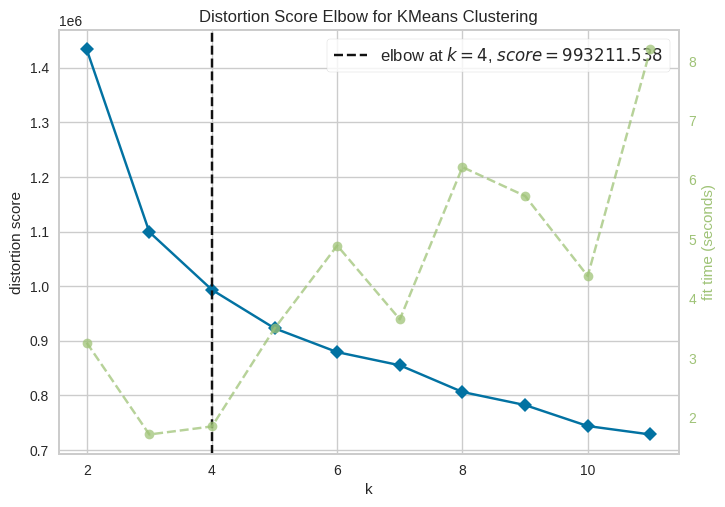

In [128]:
model = KMeans(n_init='auto')
visualiser = KElbowVisualizer(model, k=(2,12))
visualiser.fit(min_max_data)        
visualiser.show();

In [129]:
kmeans = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(min_max_data)
y_kmeans = kmeans.predict(min_max_data)
l = kmeans.labels_
l

array([1, 1, 1, ..., 3, 3, 3], dtype=int32)

In [130]:
pca = PCA(n_components=2)
temp = pca.fit_transform(min_max_data)
temp

array([[ 0.60321237, -0.07572403],
       [ 0.61668494, -0.01771058],
       [ 0.61697463, -0.03459504],
       ...,
       [-0.47112511, -0.16349241],
       [-0.47102053, -0.16350071],
       [-0.47122224, -0.13558662]])

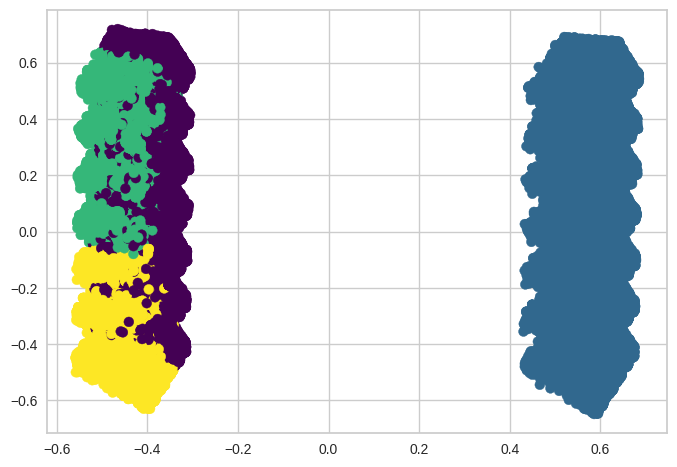

In [131]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')

In [132]:
pca = PCA(n_components=3)
temp = pca.fit_transform(min_max_data)

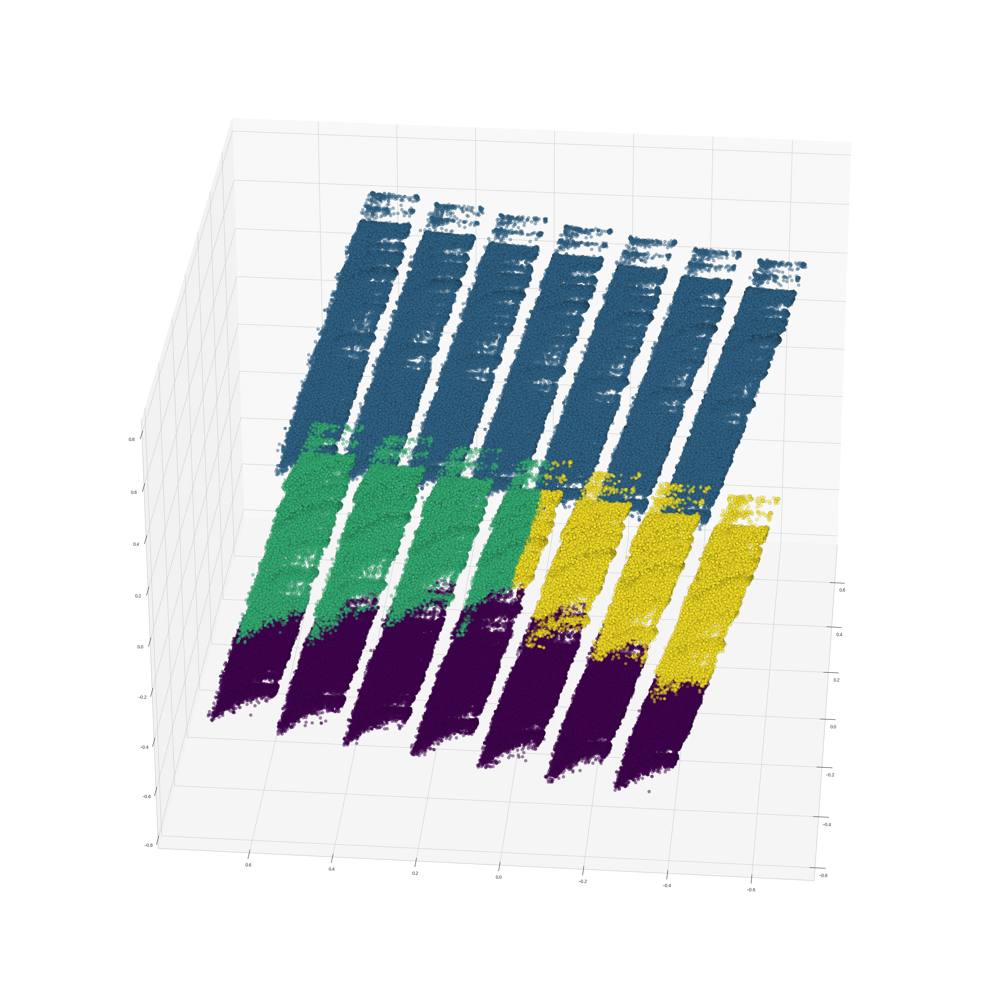

In [133]:
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2],c = y_kmeans, s=50, cmap='viridis', edgecolor='k', alpha=0.5)
ax.view_init(30, 185)
plt.show()

## QuantileTransformer

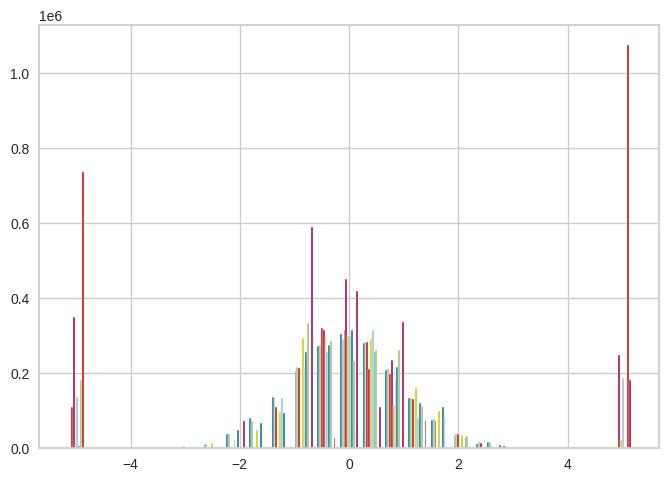

In [73]:
quantile = QuantileTransformer(output_distribution='normal')
qtdata = quantile.fit_transform(percentileData)
plt.hist(qtdata, bins=25)
plt.show()

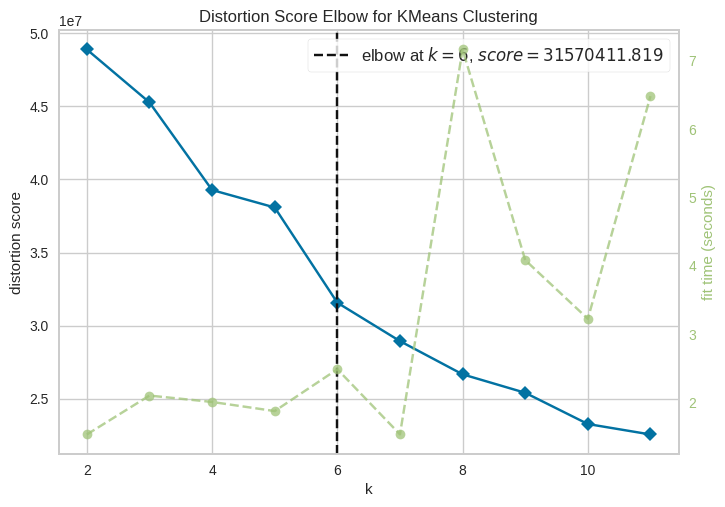

In [74]:
model = KMeans(n_init='auto')
visualiser = KElbowVisualizer(model, k=(2,12))
visualiser.fit(qtdata)        
visualiser.show();

In [87]:
kmeans = KMeans(n_clusters=6, random_state=0, n_init="auto").fit(qtdata)
y_kmeans = kmeans.predict(qtdata)
l = kmeans.labels_
l

array([3, 3, 3, ..., 2, 2, 2], dtype=int32)

In [88]:
kmeans.inertia_

33817896.82167948

In [89]:
np.unique(y_kmeans)

array([0, 1, 2, 3, 4, 5], dtype=int32)

In [90]:
pca = PCA(n_components=2)
temp = pca.fit_transform(qtdata)
temp

array([[ 6.837556  ,  0.22911208],
       [ 7.0154724 ,  0.18293969],
       [ 7.0340639 ,  0.17950942],
       ...,
       [-4.36090793,  0.12478858],
       [-4.34618797,  0.120822  ],
       [-4.34431903,  0.11671241]])

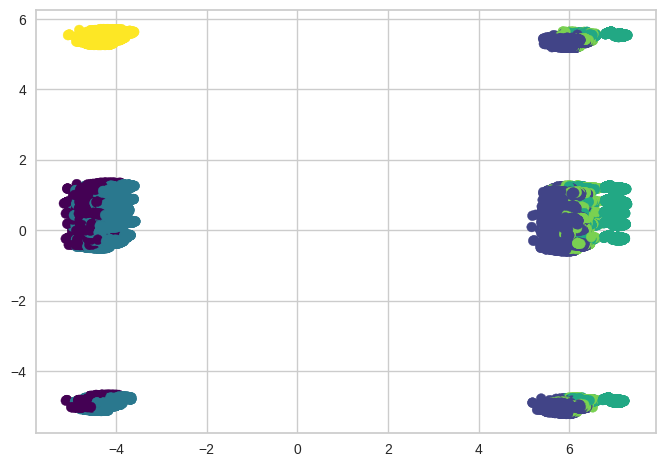

In [91]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')

In [93]:
pca = PCA(n_components=3)
temp = pca.fit_transform(qtdata)

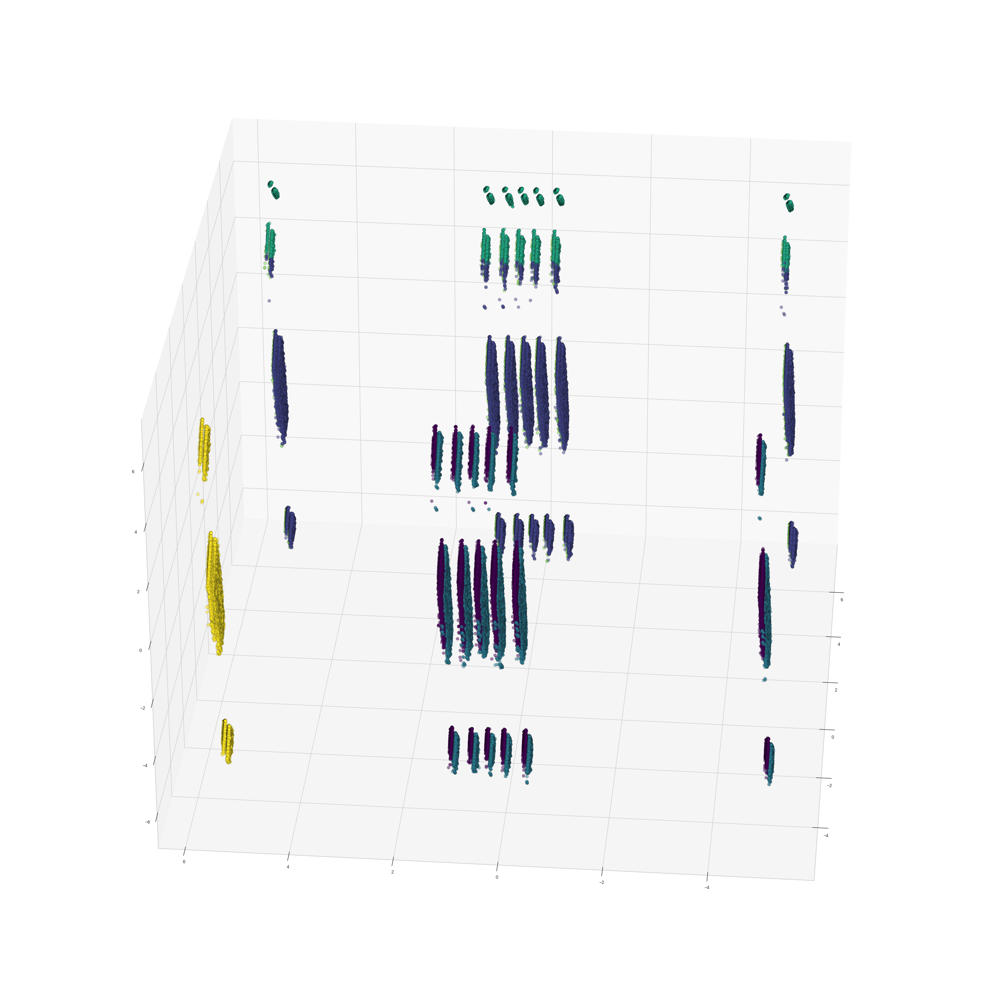

In [94]:
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2],c = y_kmeans, s=50, cmap='viridis', edgecolor='k', alpha=0.5)
ax.view_init(30, 185)
plt.show()

## PowerTransformer

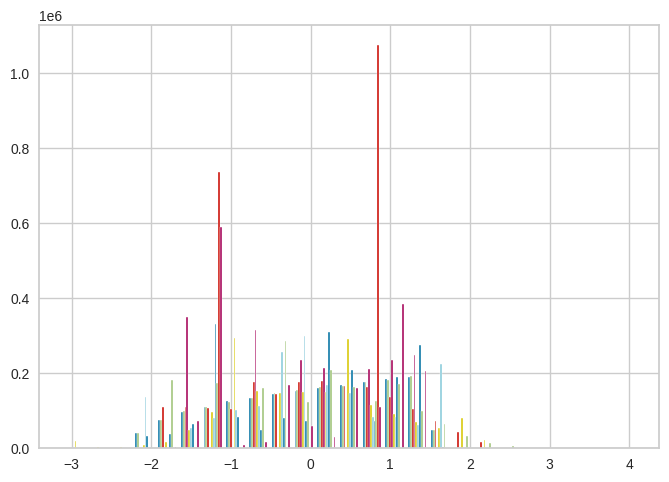

In [95]:
pt = PowerTransformer()
pdata = pt.fit_transform(percentileData)
plt.hist(pdata, bins=25)
plt.show()

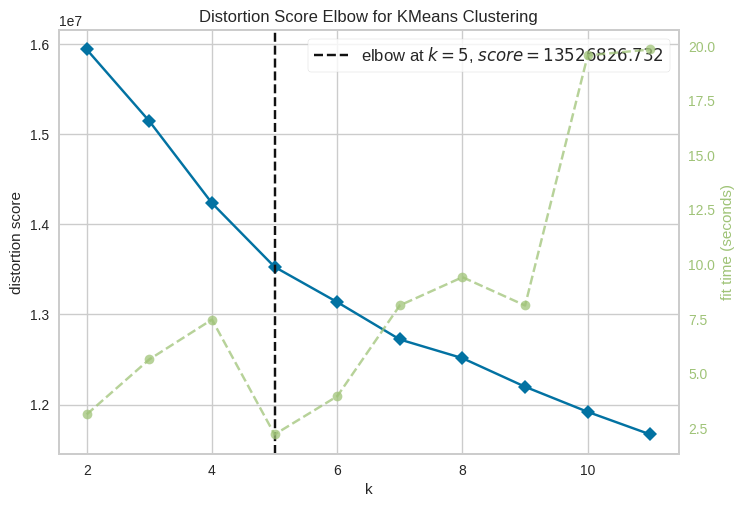

In [96]:
model = KMeans(n_init='auto')
visualiser = KElbowVisualizer(model, k=(2,12))
visualiser.fit(pdata)        
visualiser.show();

In [97]:
kmeans = KMeans(n_clusters=5, random_state=0, n_init="auto").fit(pdata)
y_kmeans = kmeans.predict(pdata)
l = kmeans.labels_
l

array([3, 3, 3, ..., 4, 4, 1], dtype=int32)

In [98]:
pca = PCA(n_components=2)
temp = pca.fit_transform(qtdata)
temp

array([[ 6.837556  ,  0.22911208],
       [ 7.0154724 ,  0.18293969],
       [ 7.0340639 ,  0.17950942],
       ...,
       [-4.36090793,  0.12478858],
       [-4.34618797,  0.120822  ],
       [-4.34431903,  0.11671241]])

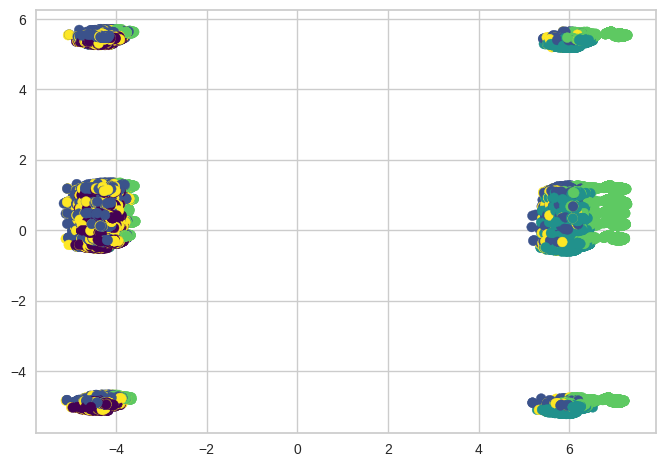

In [99]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')

In [101]:
pca = PCA(n_components=3)
temp = pca.fit_transform(pdata)

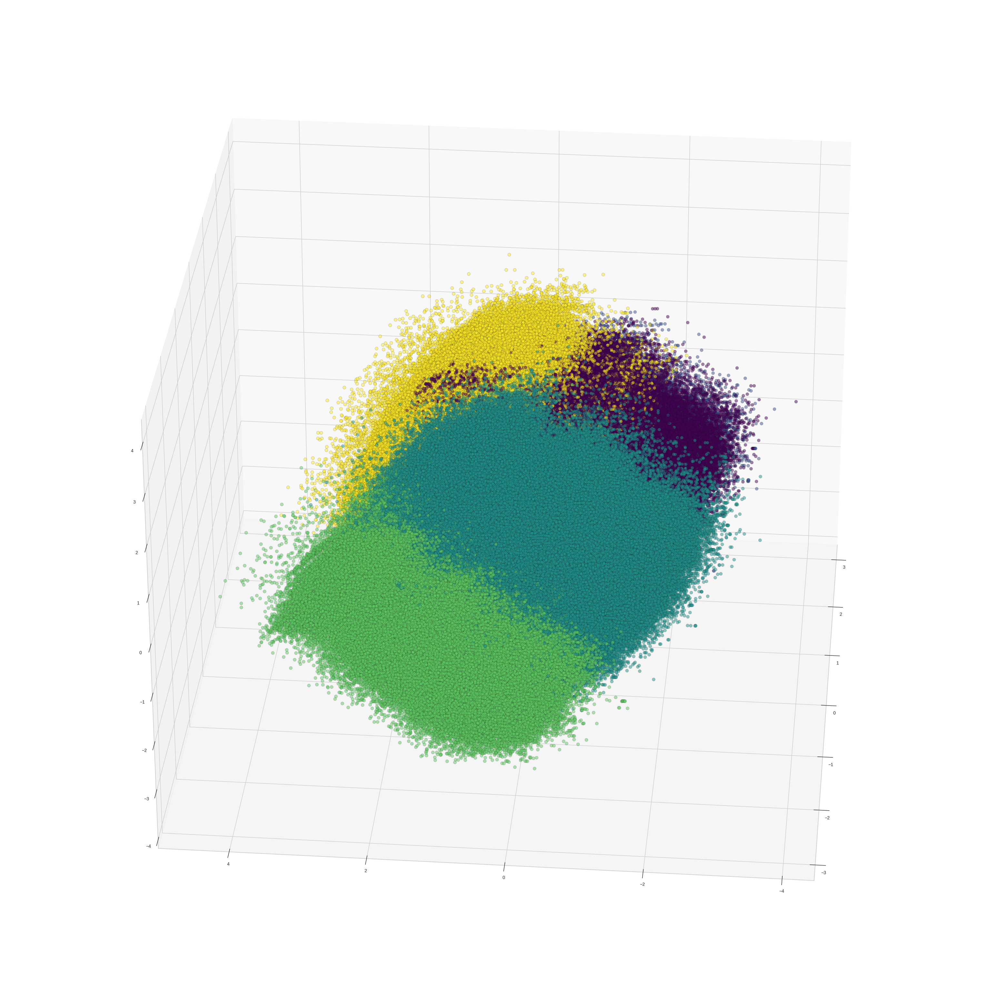

In [102]:
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2],c = y_kmeans, s=50, cmap='viridis', edgecolor='k', alpha=0.5)
ax.view_init(30, 185)
plt.show()

## After the first round of scale data


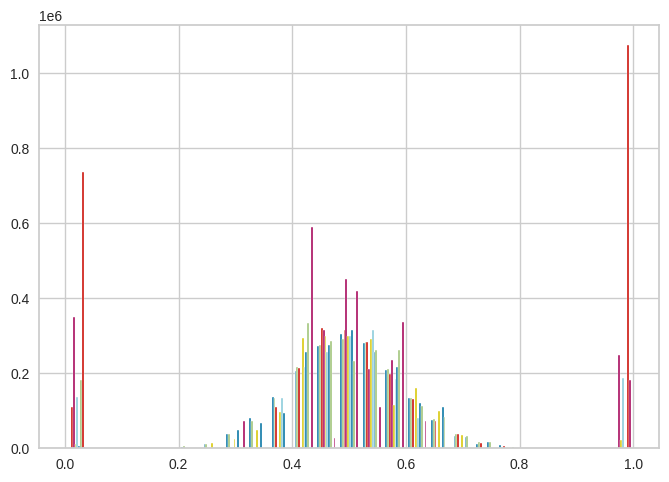

In [104]:
min_max = MinMaxScaler()
min_max_data = min_max.fit_transform(qtdata)
plt.hist(min_max_data, bins=25)
plt.show()

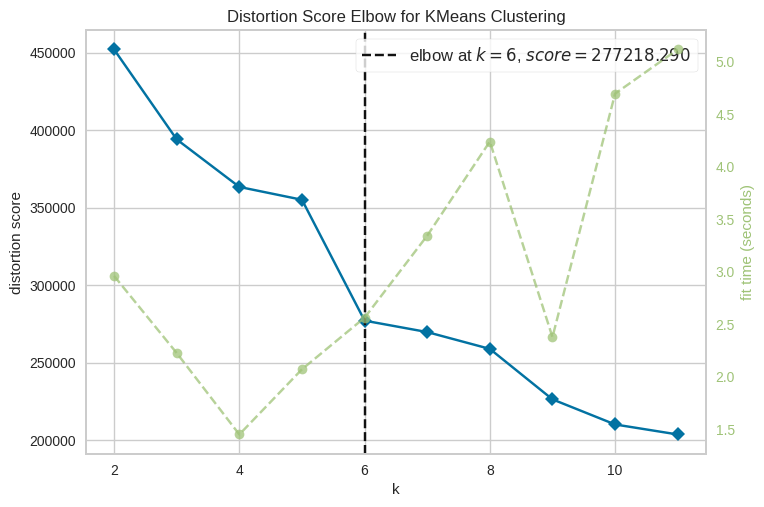

In [105]:
model = KMeans(n_init='auto')
visualiser = KElbowVisualizer(model, k=(2,12))
visualiser.fit(min_max_data)        
visualiser.show();

In [109]:
kmeans = KMeans(n_clusters=6, random_state=0, n_init="auto").fit(min_max_data)
y_kmeans = kmeans.predict(min_max_data)
l = kmeans.labels_
l

array([3, 3, 3, ..., 2, 2, 2], dtype=int32)

In [110]:
pca = PCA(n_components=2)
temp = pca.fit_transform(min_max_data)
temp

array([[ 0.65754107,  0.02203281],
       [ 0.6746506 ,  0.0175926 ],
       [ 0.67643847,  0.01726272],
       ...,
       [-0.41937149,  0.01200043],
       [-0.41795593,  0.01161898],
       [-0.4177762 ,  0.01122378]])

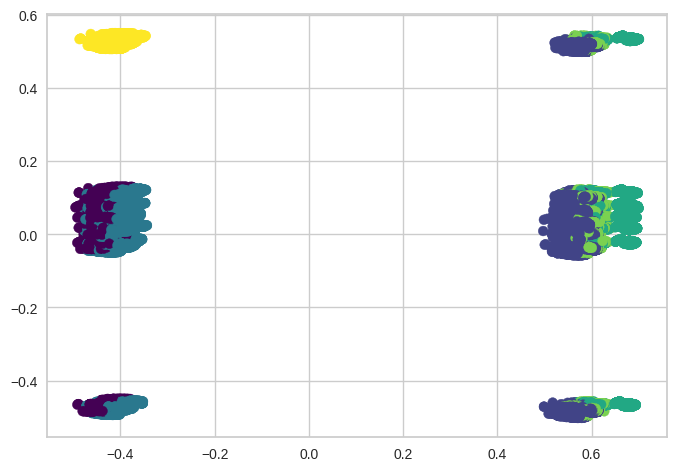

In [111]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')

In [112]:
pca = PCA(n_components=3)
temp = pca.fit_transform(min_max_data)

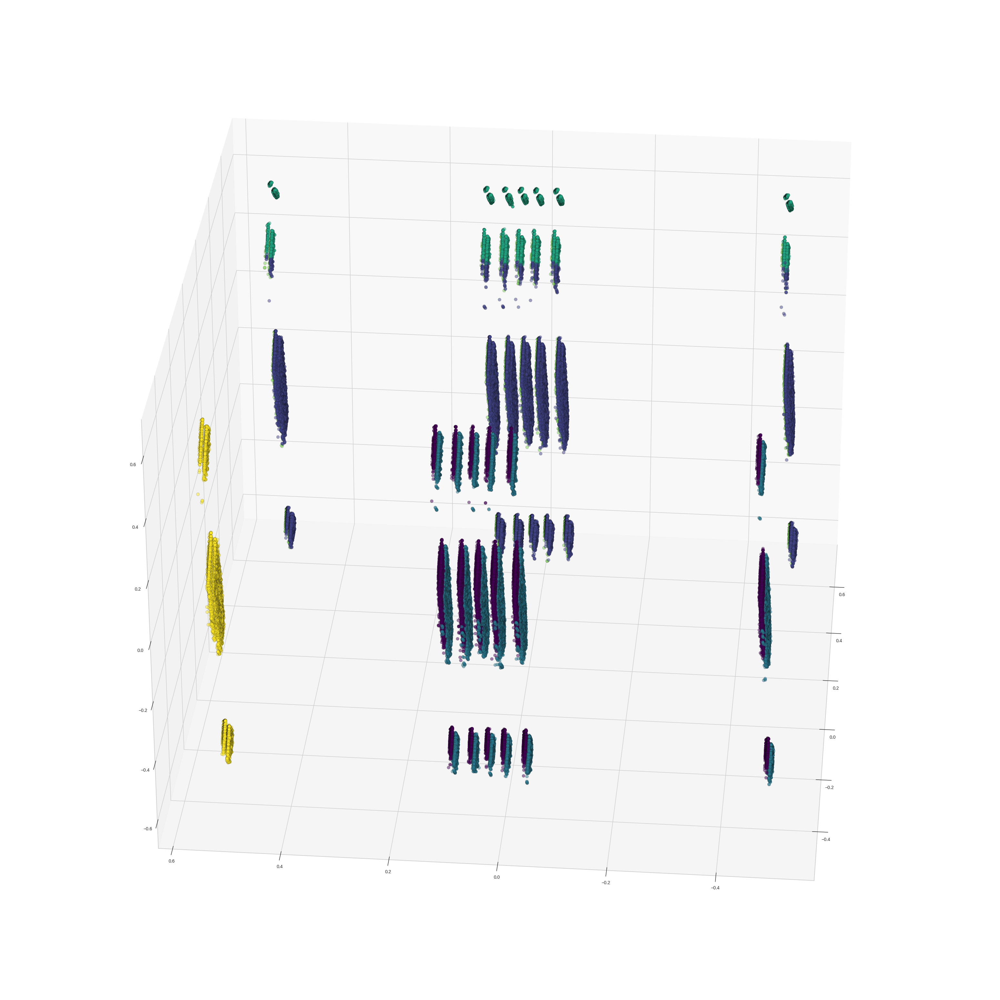

In [113]:
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2],c = y_kmeans, s=50, cmap='viridis', edgecolor='k', alpha=0.5)
ax.view_init(30, 185)
plt.show()

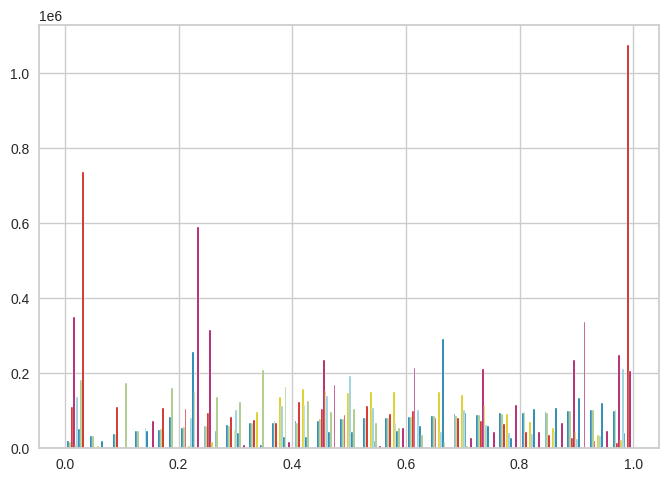

In [114]:
min_max = MinMaxScaler()
min_max_data = min_max.fit_transform(pdata)
plt.hist(min_max_data, bins=25)
plt.show()

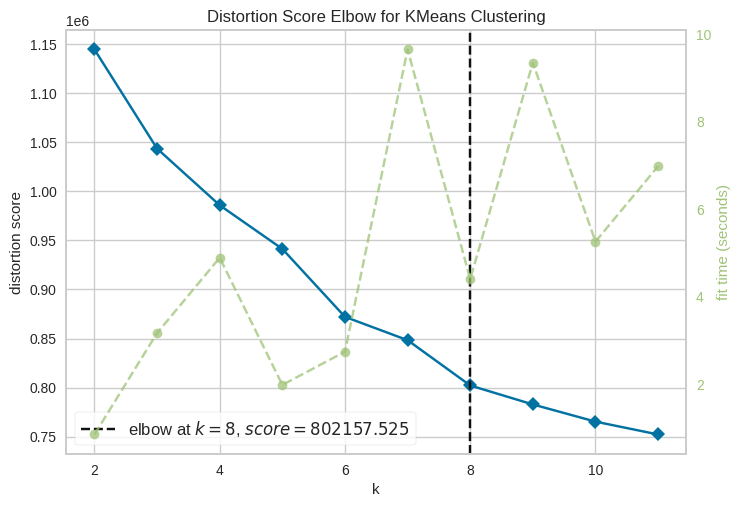

In [115]:
model = KMeans(n_init='auto')
visualiser = KElbowVisualizer(model, k=(2,12))
visualiser.fit(min_max_data)        
visualiser.show();

In [121]:
kmeans = KMeans(n_clusters=8, random_state=0, n_init="auto").fit(min_max_data)
y_kmeans = kmeans.predict(min_max_data)
l = kmeans.labels_
l

array([5, 5, 5, ..., 3, 3, 6], dtype=int32)

In [122]:
pca = PCA(n_components=2)
temp = pca.fit_transform(min_max_data)
temp

array([[ 0.69742669,  0.02541581],
       [ 0.70954239,  0.01660325],
       [ 0.71339456,  0.02032709],
       ...,
       [-0.49591363,  0.052837  ],
       [-0.49247589,  0.05375834],
       [-0.49047129,  0.04996383]])

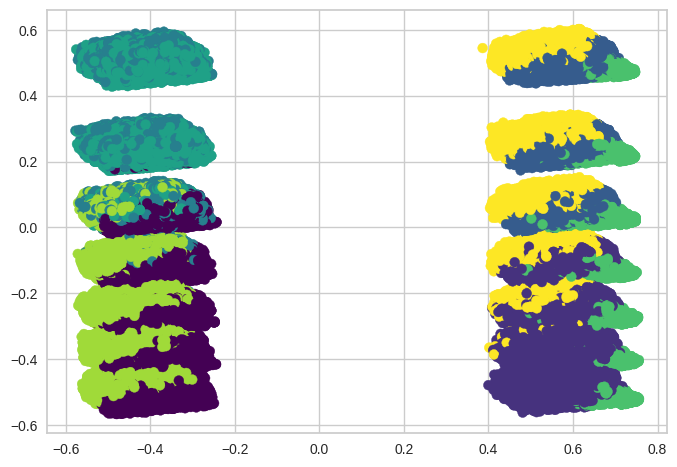

In [123]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')

In [126]:
pca = PCA(n_components=3)
temp = pca.fit_transform(min_max_data)

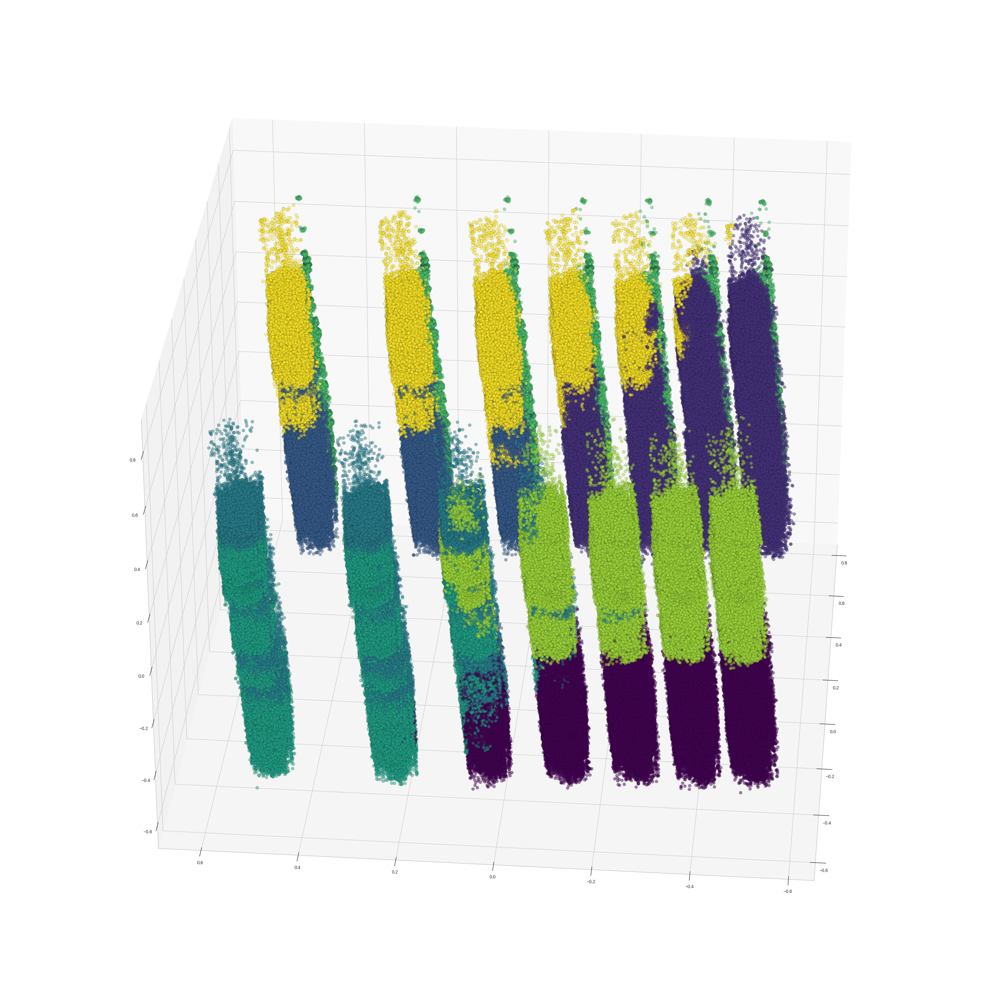

In [125]:
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2],c = y_kmeans, s=50, cmap='viridis', edgecolor='k', alpha=0.5)
ax.view_init(30, 185)
plt.show()

## DBSCAN

In [ ]:
min_max = MinMaxScaler()
min_max_data = min_max.fit_transform(percentileData)
plt.hist(min_max_data, bins=25)
plt.show()

In [ ]:
min_max_data = pd.DataFrame(min_max_data)
newSampel = min_max_data.sample(n=50000) 

In [ ]:
clustering = DBSCAN(eps=.5, min_samples=1000).fit(newSampel)
l = clustering.labels_
l

In [148]:
np.unique(l)

array([-1])

In [137]:
pca = PCA(n_components=2)
temp = pca.fit_transform(min_max_data)
temp

array([[ 0.60321237, -0.07572403],
       [ 0.61668494, -0.01771058],
       [ 0.61697463, -0.03459504],
       ...,
       [-0.47112511, -0.16349241],
       [-0.47102053, -0.16350071],
       [-0.47122224, -0.13558662]])

In [ ]:
plt.scatter(temp[:, 0], temp[:, 1], c=y_kmeans, s=50, cmap='viridis')

In [57]:
from sklearn.manifold import TSNE